In [1]:
library(Seurat)
library(Matrix)
library(ggplot2)
library(cowplot)
library(dplyr)
library(enrichR)

Registered S3 method overwritten by 'R.oo':
  method        from       
  throw.default R.methodsS3


********************************************************

Note: As of version 1.0.0, cowplot does not change the

  default ggplot2 theme anymore. To recover the previous

  behavior, execute:
  theme_set(theme_cowplot())

********************************************************



Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Welcome to enrichR
Checking connection ... 
Connection is Live!



In [2]:
AddGeneSetScore <- function(data.integrated, genes){
    sum.exp <- rowSums(FetchData(object = data.integrated,
                                   vars = genes),
                          na.rm = TRUE)

    if (all(names(x = sum.exp) == rownames(x = data.integrated@meta.data))) {
      cat("Cell names order match in 'mean.exp' and 'object@meta.data':\n", 
          "adding gene set mean expression values in 'object@meta.data$gene.set.score'")
      return (sum.exp)
    }
}

In [3]:
data.list <- c()
data.dirs <- list.files("/data/share/scRNAseq//results/human_STAD/",
                        full.names = TRUE,
                        pattern="N-total")

In [4]:
data.dirs

[1] "/data/share/scRNAseq//results/human_STAD//10N-total"
 [2] "/data/share/scRNAseq//results/human_STAD//11N-total"
 [3] "/data/share/scRNAseq//results/human_STAD//12N-total"
 [4] "/data/share/scRNAseq//results/human_STAD//14N-total"
 [5] "/data/share/scRNAseq//results/human_STAD//15N-total"
 [6] "/data/share/scRNAseq//results/human_STAD//16N-total"
 [7] "/data/share/scRNAseq//results/human_STAD//17N-total"
 [8] "/data/share/scRNAseq//results/human_STAD//18N-total"
 [9] "/data/share/scRNAseq//results/human_STAD//6N-total" 
[10] "/data/share/scRNAseq//results/human_STAD//8N-total" 
[11] "/data/share/scRNAseq//results/human_STAD//9N-total"

In [14]:
for (i in 1:length(data.dirs)){
    data.list <- c(data.list, Read10X(paste0(data.dirs[i],"/outs/filtered_feature_bc_matrix")))
}

In [25]:
length(data.list)

[1] 11

In [15]:
options(warn=-1)

for (i in 1:length(data.dirs)){
    sample <- strsplit(data.dirs[i], "/")[[1]]
    sample <- sample[length(sample)]
    data.list[[i]] <- CreateSeuratObject(data.list[[i]], project = sample, min.cells = 2)
#    data.list[[i]] <- PercentageFeatureSet(data.list[[i]],pattern = '^MT-', col.name = 'percent.mt')
    data.list[[i]] <- SCTransform(data.list[[i]], verbose = FALSE)
}
options(warn=0)

In [16]:
options(future.globals.maxSize= 10*1024^3)

In [17]:
data.features <- SelectIntegrationFeatures(object.list=data.list, nfeatures=3000)
data.list <- PrepSCTIntegration(object.list=data.list, anchor.features=data.features,
                               verbose=FALSE)

In [18]:
reference_dataset <- 1

In [19]:
data.anchors <- FindIntegrationAnchors(object.list = data.list, normalization.method='SCT',
            anchor.features = data.features, reference=1, verbose=FALSE)

Warning message in CheckDuplicateCellNames(object.list = object.list):
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”

In [20]:
data.integrated <- IntegrateData(anchorset = data.anchors, normalization.method='SCT')

Integrating dataset 2 with reference dataset
Finding integration vectors
Finding integration vector weights
Integrating data
Integrating dataset 3 with reference dataset
Finding integration vectors
Finding integration vector weights
Integrating data
Integrating dataset 4 with reference dataset
Finding integration vectors
Finding integration vector weights
Integrating data
Integrating dataset 5 with reference dataset
Finding integration vectors
Finding integration vector weights
Integrating data
Integrating dataset 6 with reference dataset
Finding integration vectors
Finding integration vector weights
Integrating data
Integrating dataset 7 with reference dataset
Finding integration vectors
Finding integration vector weights
Integrating data
Integrating dataset 8 with reference dataset
Finding integration vectors
Finding integration vector weights
Integrating data
Integrating dataset 9 with reference dataset
Finding integration vectors
Finding integration vector weights
Integrating data


In [21]:
data.integrated <- RunPCA(object=data.integrated, verbose=FALSE)

In [6]:
reticulate::import(module = "umap")

Module(umap)

In [23]:
data.integrated <- RunUMAP(data.integrated, dims = 1:30, verbose = FALSE, umap.method = 'umap-learn', metric = 'correlation')

In [24]:
data.integrated <- FindNeighbors(data.integrated, dims = 1:30, verbose = FALSE)
data.integrated <- FindClusters(data.integrated, verbose = FALSE)

In [25]:
data.integrated

An object of class Seurat 
42921 features across 38416 samples within 3 assays 
Active assay: integrated (3000 features)
 2 other assays present: RNA, SCT
 2 dimensional reductions calculated: pca, umap

In [26]:
save(data.integrated, file='NewData-stomach-reference20190907.RData')

# ------------------------------------------------------------------------------------

In [5]:
load('NewData-stomach-reference20190907.RData')

Warning message:
“Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session.”


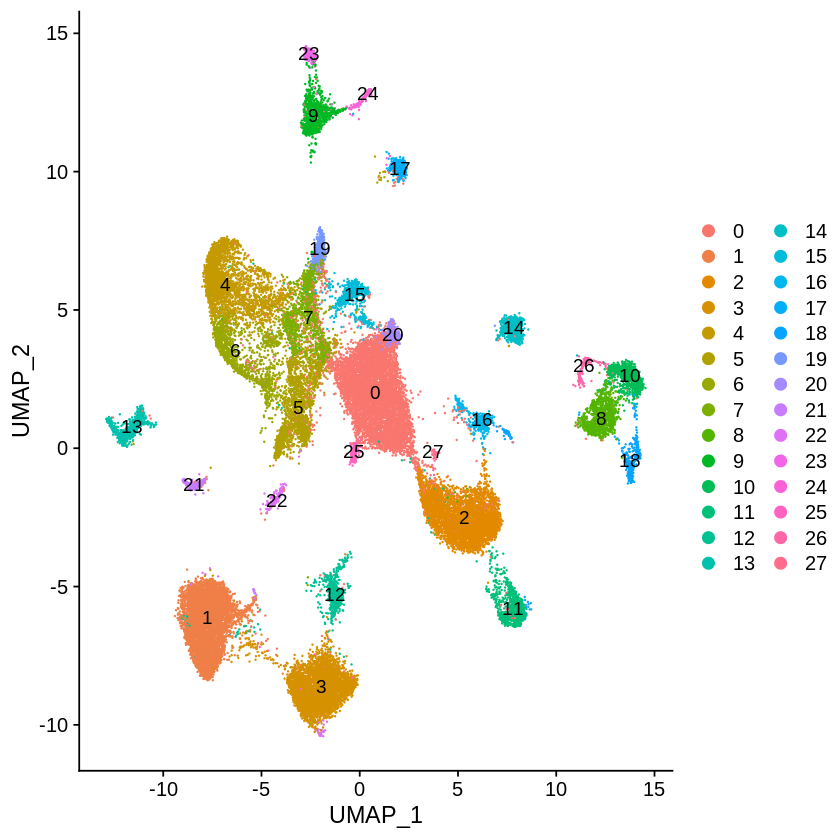

In [7]:
options(repr.plot.width=7, repr.plot.height=7)
DimPlot(data.integrated, label = TRUE)

In [40]:
epi_markers <- c('TFF1','TFF2','PGA4','CA2','MUC1','MUC5AC','CEL','REG1A',
                'GKN2','OLFM4','KRT19','SPINK1', 'LCN2','ATP4B','SOX4',
                'IFI6','MLN','KRT20','CEACAM5','CEACAM6','GIF')

In [41]:
epi_markers <- c("TFF1","TFF2","PGA4","CA2","MUC1","MUC5AC","REG1A",
                 "GKN2","OLFM4","KRT19","SPINK1", "LCN2","ATP4B","SOX4",
                 "IFI6","MLN","KRT20","CEACAM5","CEACAM6","GIF", "ALDH1A1",
                 "CKB","BEST4","GUCA2A","CHGA","PCSK1N","GHRL","TACSTD2",
                 "CCDC80","IGFBP6","GAST","CEL")

Warning message:
“Found the following features in more than one assay, excluding the default. We will not include these in the final dataframe: PGA4, OLFM4, ATP4B, MLN, CEACAM6, GIF, BEST4, GUCA2A, GAST, CEL”Warning message in FetchData(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: PGA4, OLFM4, ATP4B, MLN, CEACAM6, GIF, BEST4, GUCA2A, GAST, CEL”

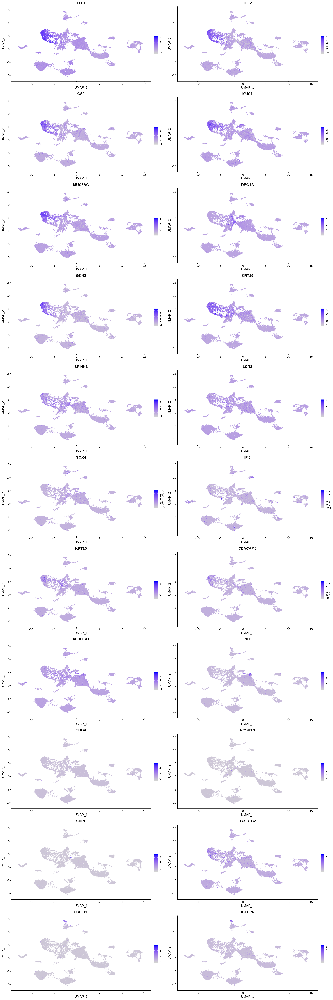

In [42]:
options(repr.plot.width=20, repr.plot.height=60)
FeaturePlot(object = data.integrated, features = epi_markers,ncol=2)

Warning message:
“Found the following features in more than one assay, excluding the default. We will not include these in the final dataframe: PGA4, OLFM4, ATP4B, MLN, CEACAM6, GIF, BEST4, GUCA2A, GAST, CEL”Warning message in FetchData(object = object, vars = features, slot = slot):
“The following requested variables were not found: PGA4, OLFM4, ATP4B, MLN, CEACAM6, GIF, BEST4, GUCA2A, GAST, CEL”

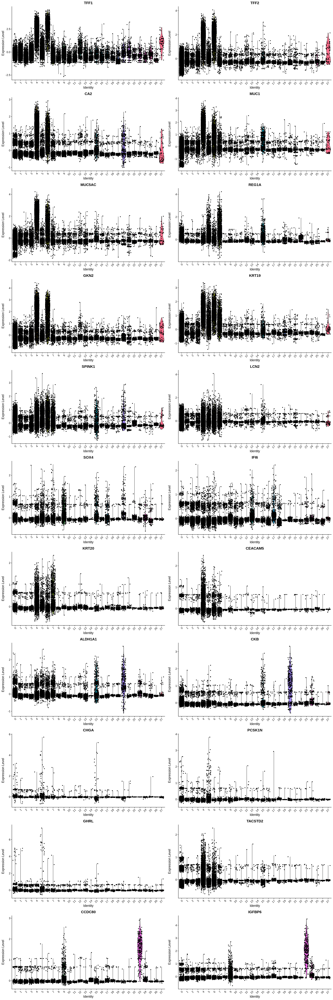

In [36]:
VlnPlot(object = data.integrated, features = epi_markers, ncol =2)

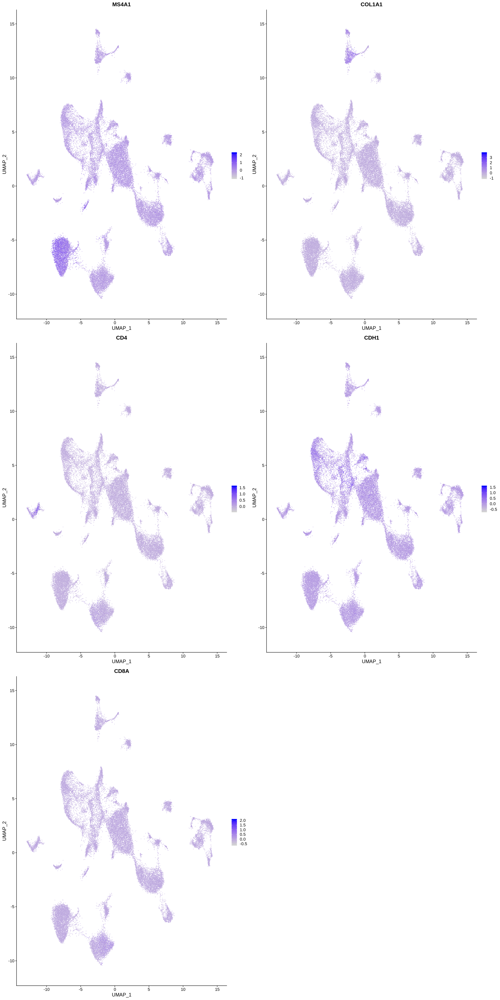

In [45]:
options(repr.plot.width=20, repr.plot.height=40)
# MS4A1 -> B cell
# COL1A1-> fibroblast
# CD4 -> helper T cell
# CDH1 ->
# CD8A -> killer T cell
FeaturePlot(object = data.integrated, features = c("MS4A1", "COL1A1","CD4","CDH1","CD8A"), ncol = 2)
#, blend = TRUE, ncol = 3)

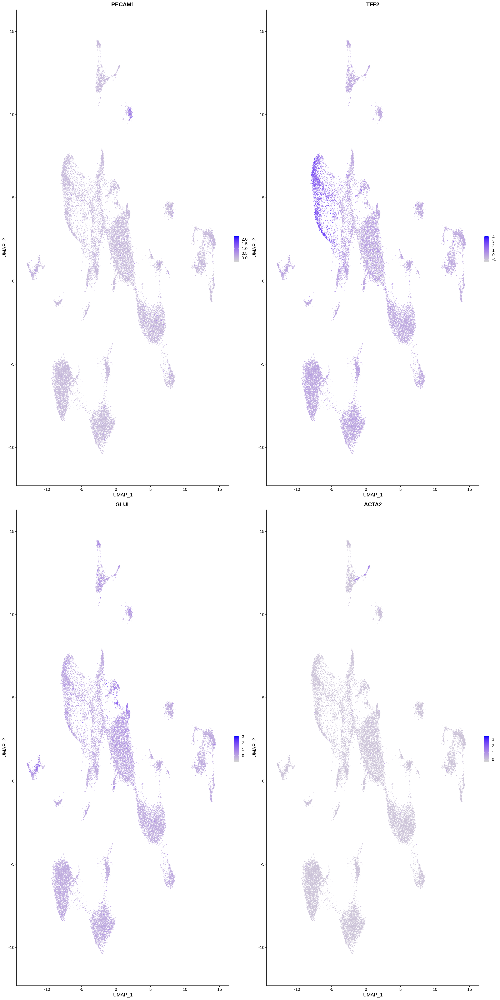

In [46]:
# PECAM1 -> 血管内皮細胞
# VWFもみたい
# TFF2   -> gastric mucosa?
# GLUL   -> グルタミンシンターゼ
# ACTA2  -> 平滑筋
FeaturePlot(object = data.integrated, features = c("PECAM1","TFF2","GLUL","ACTA2"), ncol = 2)

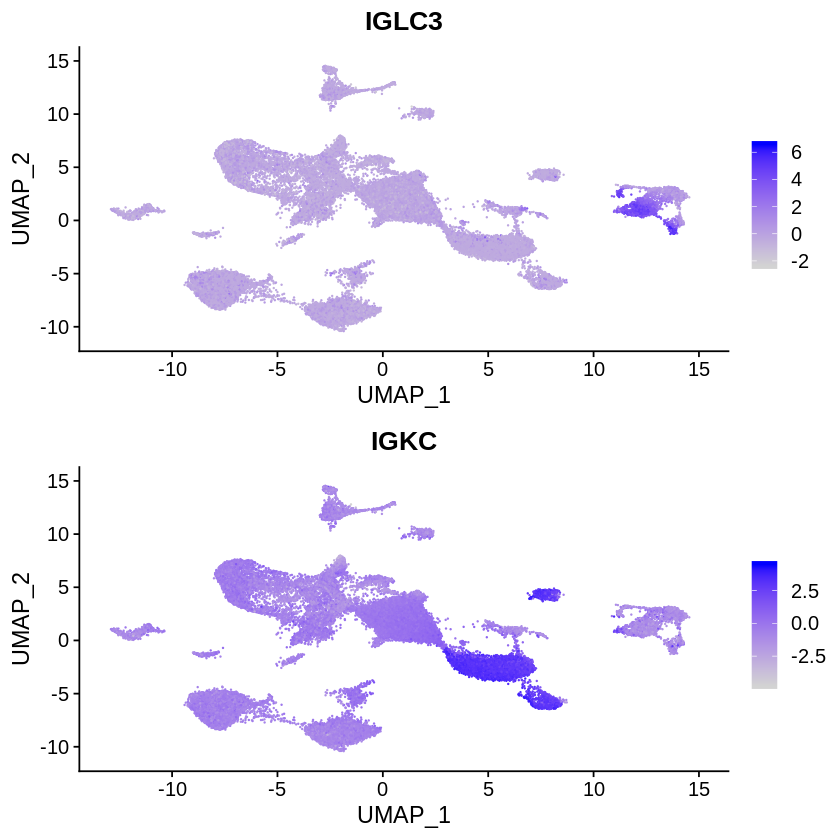

In [47]:
options(repr.plot.width=7, repr.plot.height=7)
FeaturePlot(object = data.integrated, features = c("IGLC3","IGKC"),ncol=1)

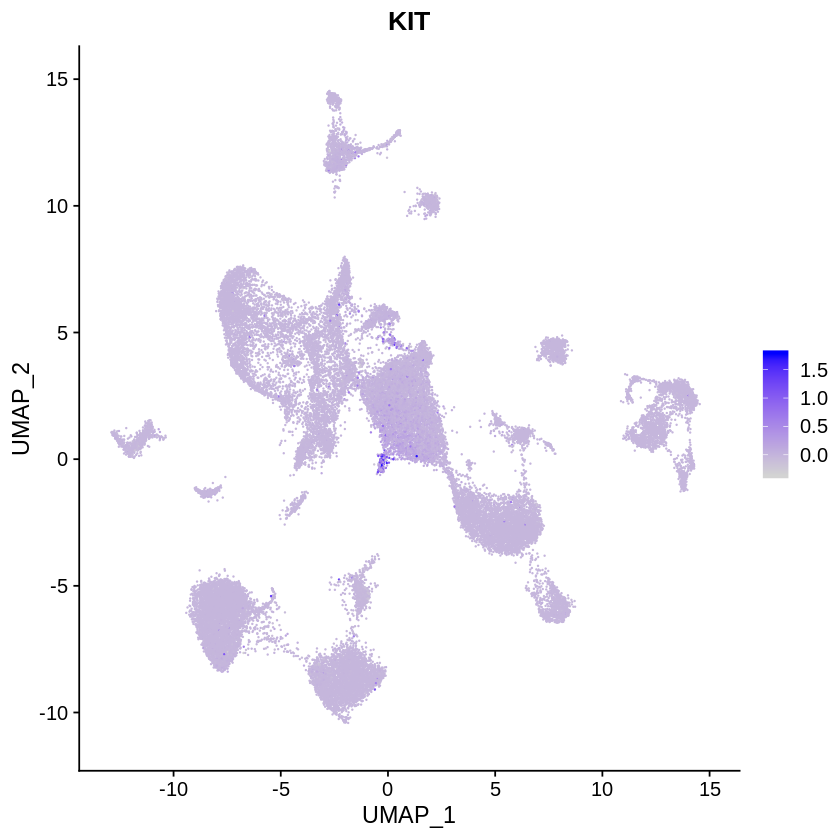

In [48]:
FeaturePlot(object = data.integrated, features = c("KIT"),ncol=2)

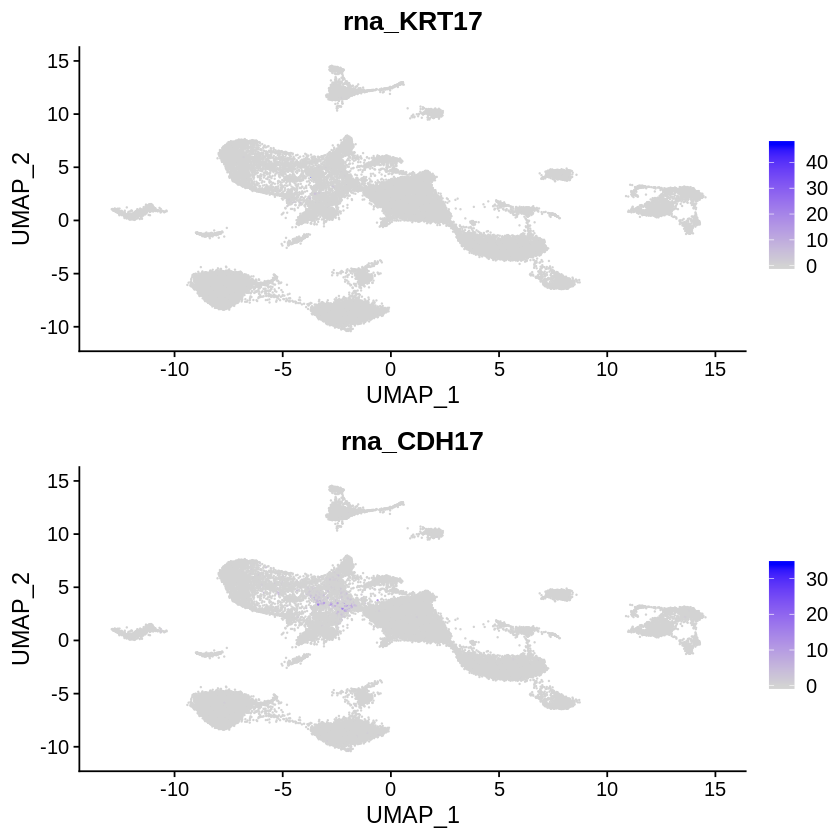

In [49]:
FeaturePlot(object = data.integrated, features = c("rna_KRT17","rna_CDH17"),ncol=1)

Cell names order match in 'mean.exp' and 'object@meta.data':
 adding gene set mean expression values in 'object@meta.data$gene.set.score'Cell names order match in 'mean.exp' and 'object@meta.data':
 adding gene set mean expression values in 'object@meta.data$gene.set.score'Cell names order match in 'mean.exp' and 'object@meta.data':
 adding gene set mean expression values in 'object@meta.data$gene.set.score'

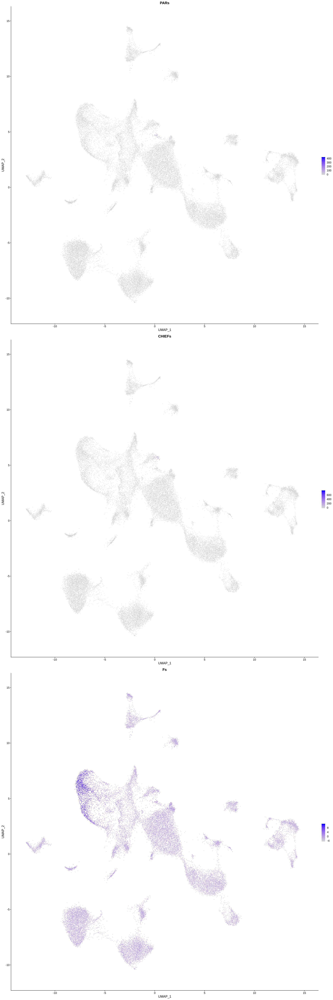

In [49]:
data.integrated$CHIEFs <- AddGeneSetScore(data.integrated,
                                   c("LIPF","PGC","rna_PGA3","rna_PGA4","rna_PGA5"))
data.integrated$PARs <- AddGeneSetScore(data.integrated,
                                   c("rna_ATP4B","rna_GIF"))
data.integrated$Fs <- AddGeneSetScore(data.integrated,
                                   c("GKN1", "PSCA","MUC5AC"))

options(repr.plot.width=20, repr.plot.height=60)
FeaturePlot(object = data.integrated, features = c("PARs","CHIEFs","Fs"), ncol=1, pt.size = 0.1)

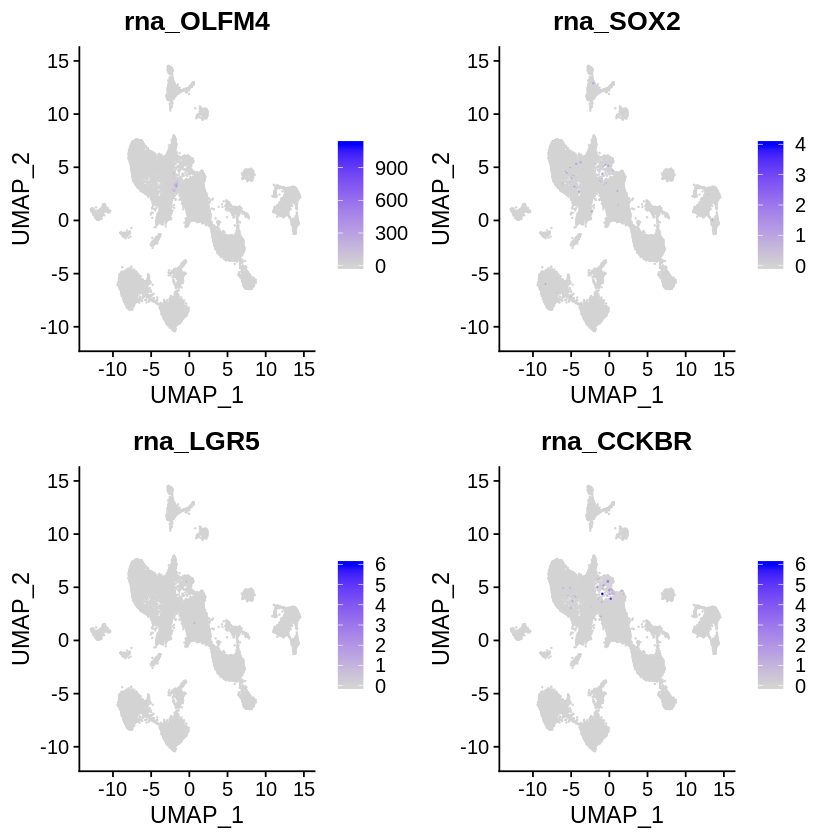

In [50]:
# 腸管細胞
FeaturePlot(object = data.integrated, features = c('rna_OLFM4','rna_SOX2','rna_LGR5','rna_CCKBR'))

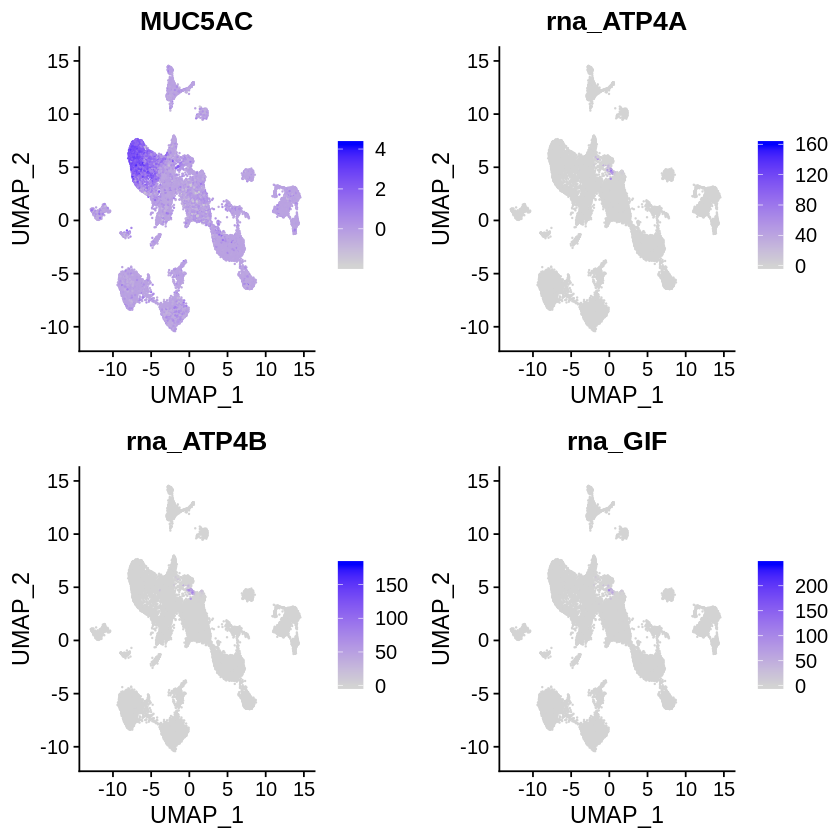

In [51]:
#epithelium
FeaturePlot(object = data.integrated, features = c("MUC5AC",'rna_ATP4A',"rna_ATP4B","rna_GIF"))

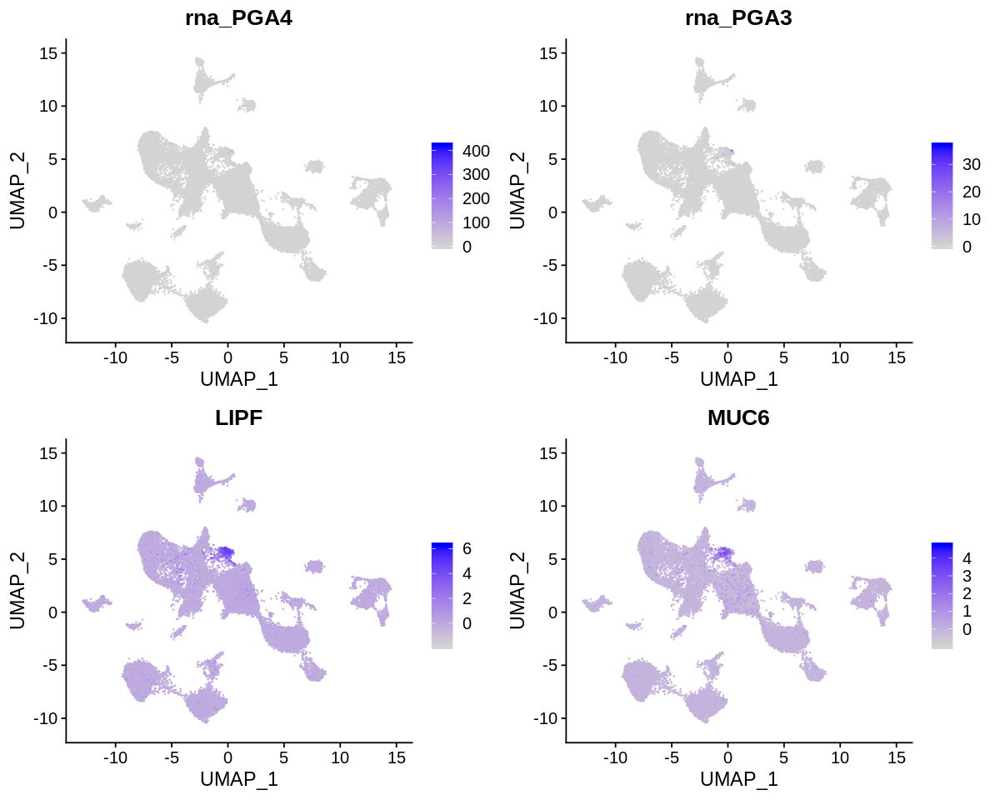

In [52]:
#intestinal metaplasia
options(repr.plot.width=10, repr.plot.height=8)
FeaturePlot(object = data.integrated, features = c('rna_PGA4', "rna_PGA3",'LIPF',"MUC6"), ncol = 2)

Warning message in FetchData(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: rna_TAC1, rna_NEUROG3”

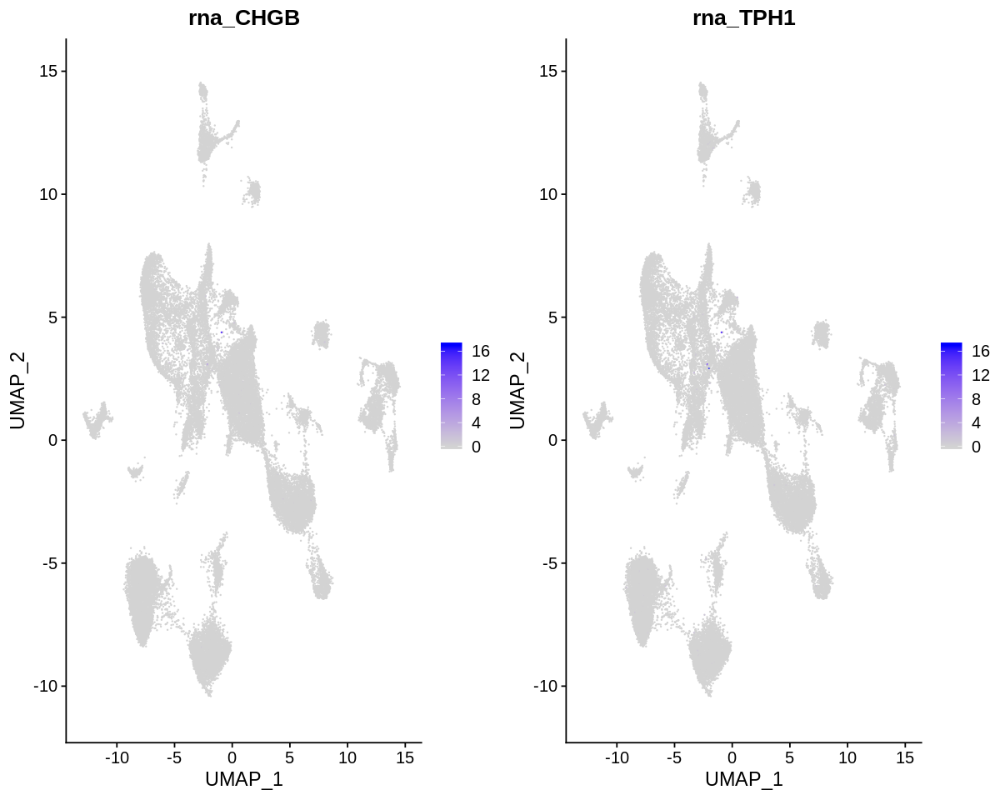

In [53]:
#intestinal metaplasia
options(repr.plot.width=10, repr.plot.height=8)
FeaturePlot(object = data.integrated, features = c('rna_CHGB','rna_TAC1','rna_TPH1','rna_NEUROG3'), ncol = 2)

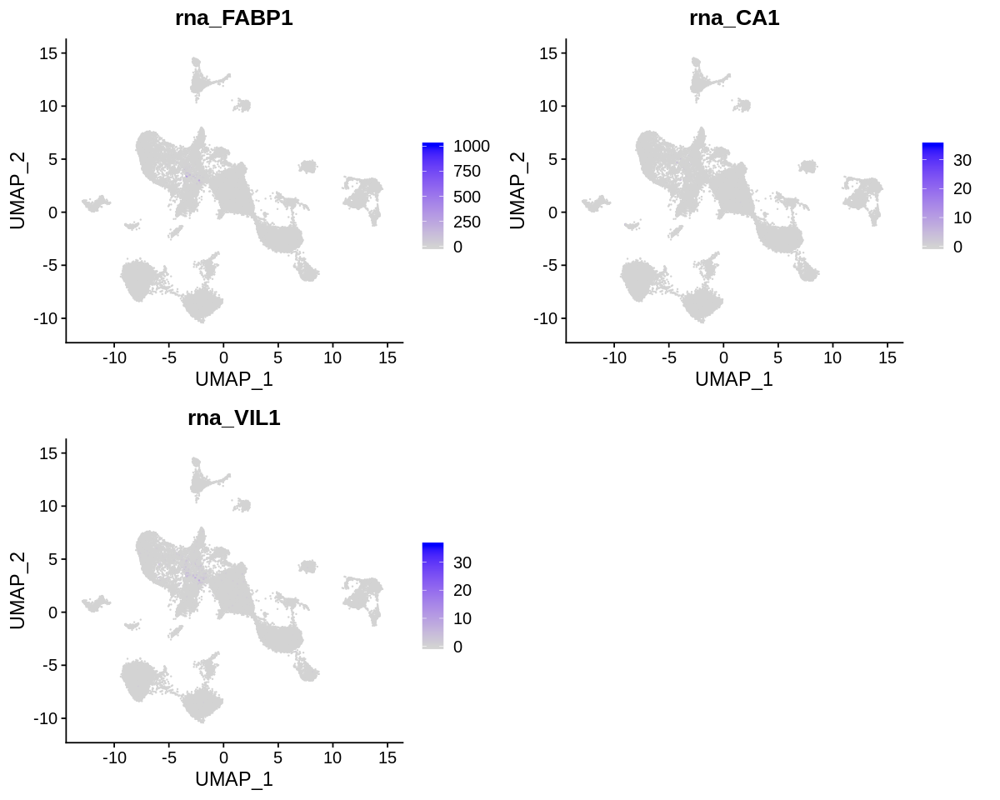

In [54]:
#intestinal metaplasia
options(repr.plot.width=10, repr.plot.height=8)
FeaturePlot(object = data.integrated, features = c('rna_FABP1','rna_CA1','rna_VIL1'), ncol = 2)

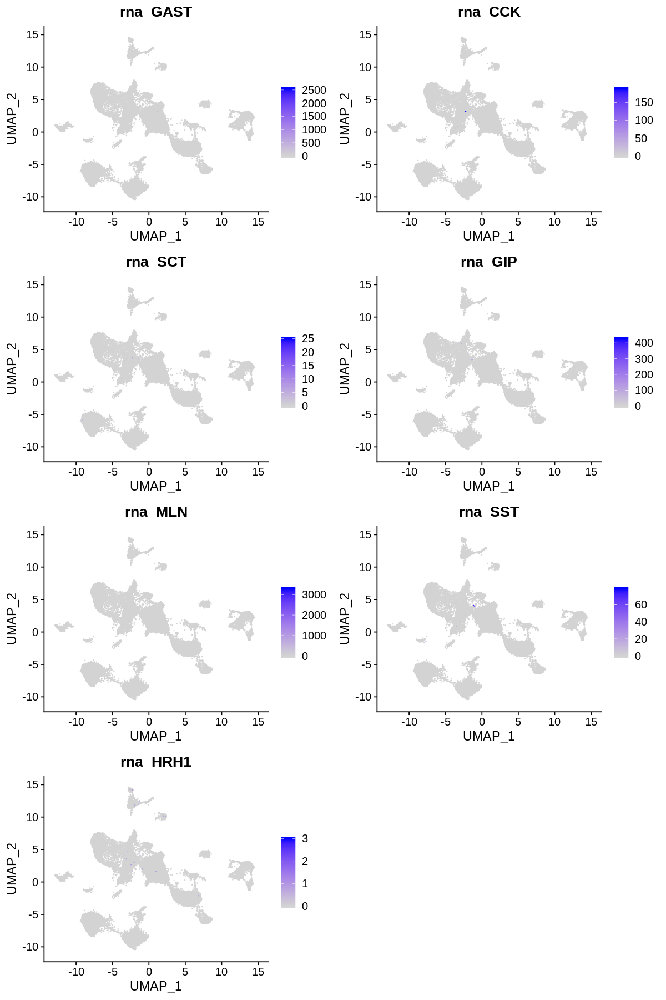

In [55]:
#endocrine
options(repr.plot.width=10, repr.plot.height=15)
FeaturePlot(object = data.integrated, features = c("rna_GAST","rna_CCK","rna_SCT","rna_GIP","rna_MLN","rna_SST","rna_HRH1"), ncol = 2)

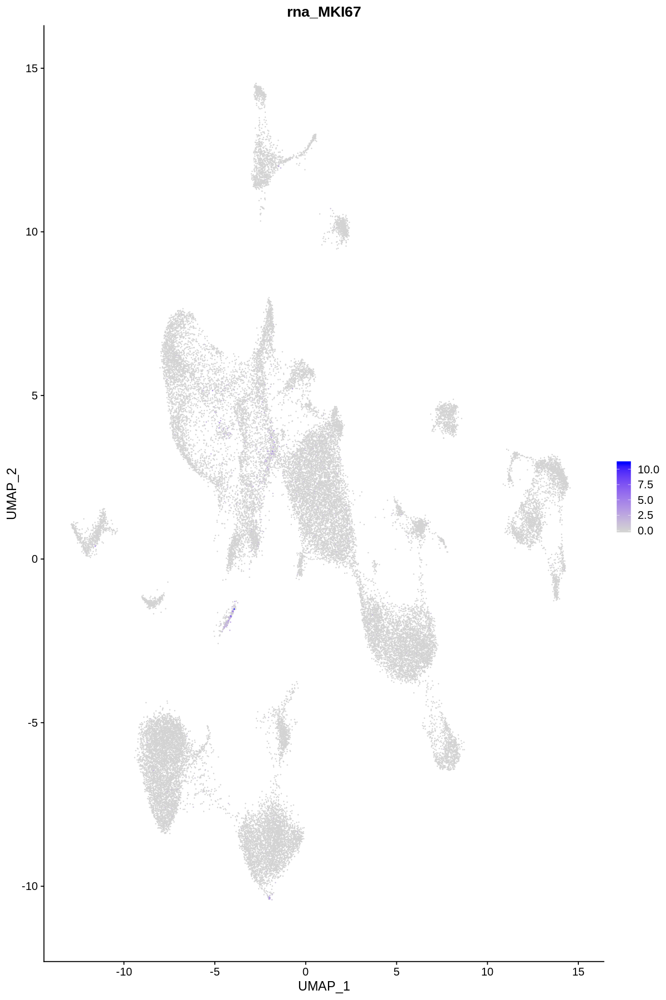

In [56]:
FeaturePlot(object = data.integrated, features = c("rna_MKI67"))

In [8]:
library(schex)

Loading required package: SingleCellExperiment

Loading required package: SummarizedExperiment

Loading required package: GenomicRanges

Loading required package: stats4

Loading required package: BiocGenerics

Loading required package: parallel


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following object is masked from ‘package:Matrix’:

    which


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find, get, grep,
    grepl, intersect, is.unsorted

In [11]:
data.integrated

An object of class Seurat 
42921 features across 38416 samples within 3 assays 
Active assay: SCT (18247 features)
 2 other assays present: RNA, integrated
 2 dimensional reductions calculated: pca, umap

In [10]:
DefaultAssay(data.integrated) <- 'SCT'

In [37]:
data_MS4A1 <- make_hexbin(as.SingleCellExperiment(data.integrated), nbins=60, dimension_reduction = 'UMAP')

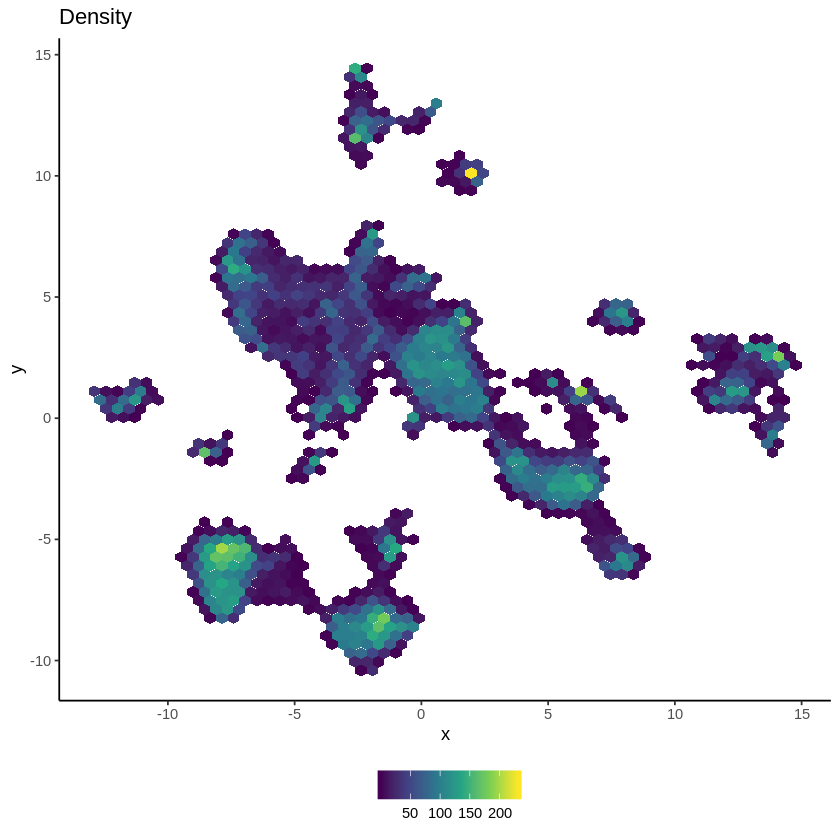

In [38]:
plot_hexbin_density(data_MS4A1)

In [21]:
data_MS4A1

class: SingleCellExperiment 
dim: 18247 38416 
metadata(1): hexbin
assays(2): counts logcounts
rownames(18247): AL669831.5 LINC00115 ... TMEM190 LINC01634
rowData names(0):
colnames(38416): AAACCTGAGGCTAGCA_1 AAACCTGCAAGTTAAG_1 ...
  TTTGTCACAGACAAGC_11 TTTGTCACATTACCTT_11
colData names(8): orig.ident nCount_RNA ... seurat_clusters ident
reducedDimNames(2): PCA UMAP
spikeNames(0):
altExpNames(0):

In [26]:
data_MS4A1

class: SingleCellExperiment 
dim: 18247 38416 
metadata(1): hexbin
assays(2): counts logcounts
rownames(18247): AL669831.5 LINC00115 ... TMEM190 LINC01634
rowData names(0):
colnames(38416): AAACCTGAGGCTAGCA_1 AAACCTGCAAGTTAAG_1 ...
  TTTGTCACAGACAAGC_11 TTTGTCACATTACCTT_11
colData names(8): orig.ident nCount_RNA ... seurat_clusters ident
reducedDimNames(2): PCA UMAP
spikeNames(0):
altExpNames(0):

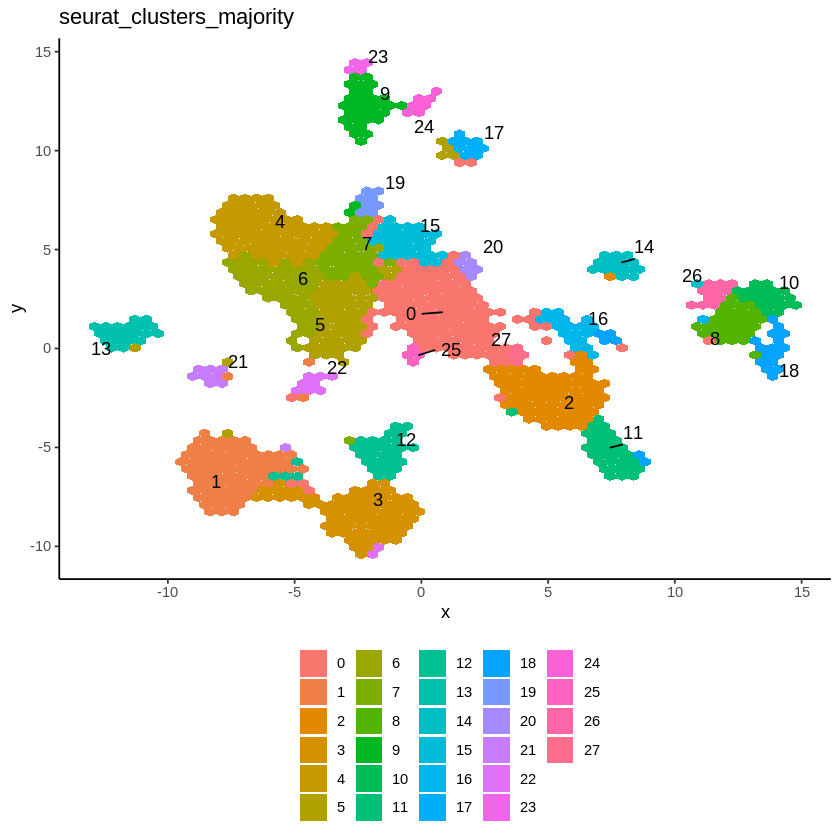

In [39]:
label_df <- make_hexbin_label(data_MS4A1, col = "seurat_clusters")
pp <- plot_hexbin_meta(data_MS4A1, col = "seurat_clusters", action = "majority")
pp + ggrepel::geom_label_repel(data = label_df, aes(x = x, y = y, label = label), colour = "black", 
    label.size = NA, fill = NA)

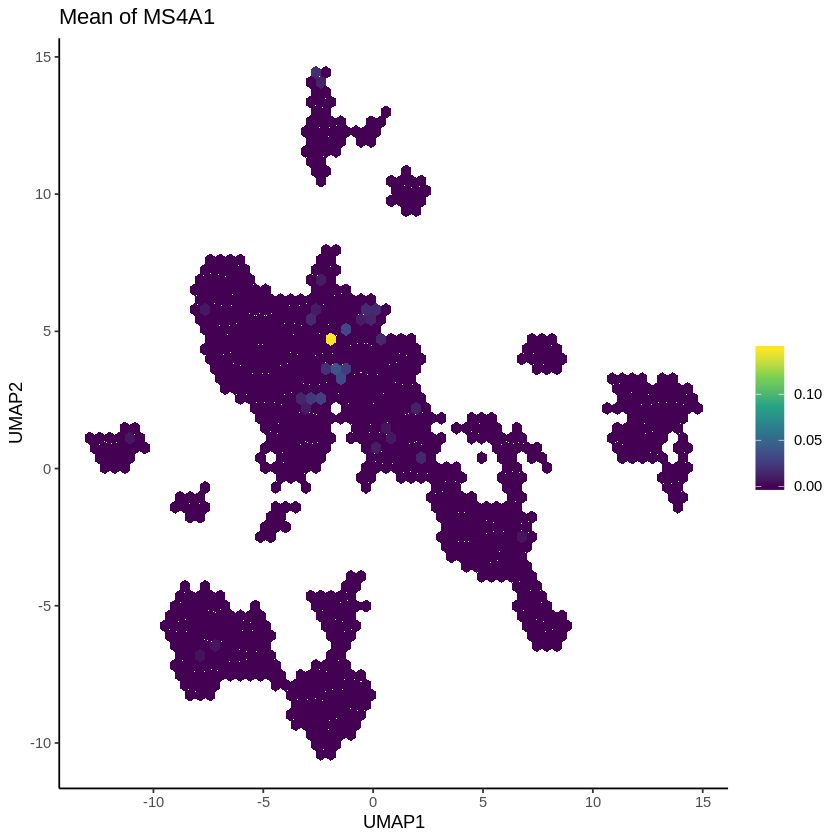

In [46]:
plot_hexbin_gene(data_MS4A1,type = "logcounts", gene = 'LGR5', action = "mean", xlab = "UMAP1", ylab = "UMAP2", 
    title = paste0("Mean of MS4A1"))

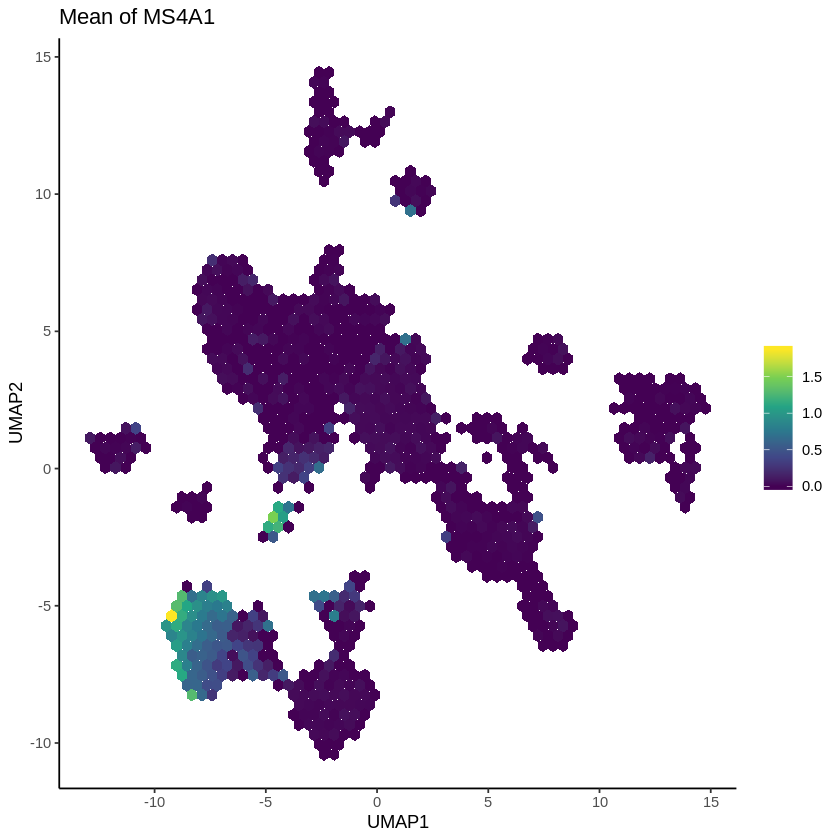

In [40]:
plot_hexbin_gene(data_MS4A1,type = "logcounts", gene = 'MS4A1', action = "mean", xlab = "UMAP1", ylab = "UMAP2", 
    title = paste0("Mean of MS4A1"))

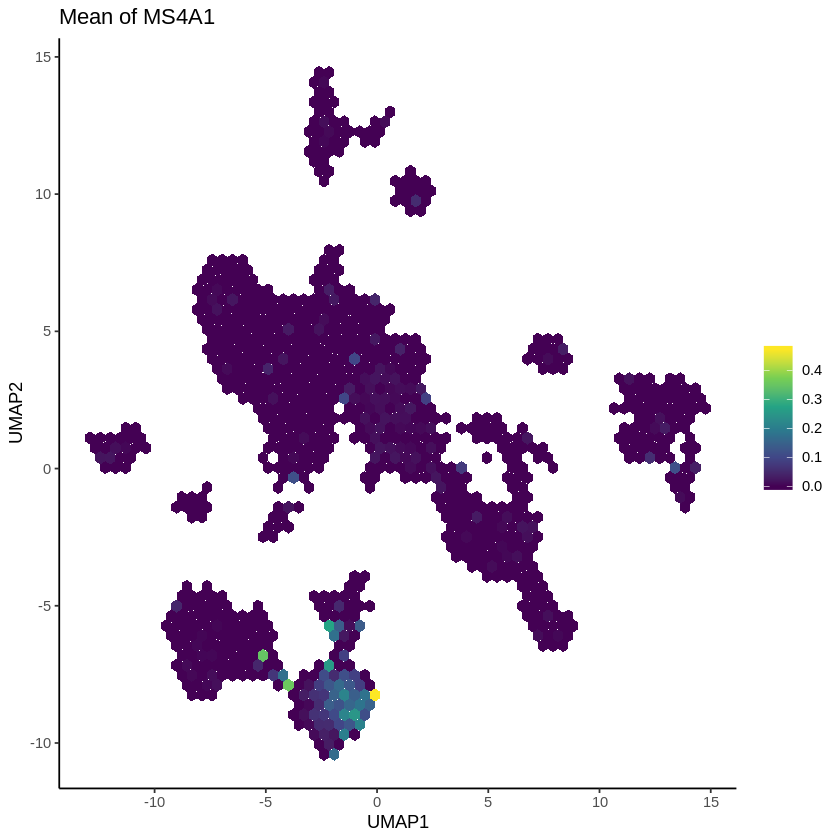

In [45]:
plot_hexbin_gene(data_MS4A1,type = "logcounts", gene = 'CD8A', action = "mean", xlab = "UMAP1", ylab = "UMAP2", 
    title = paste0("Mean of MS4A1"))

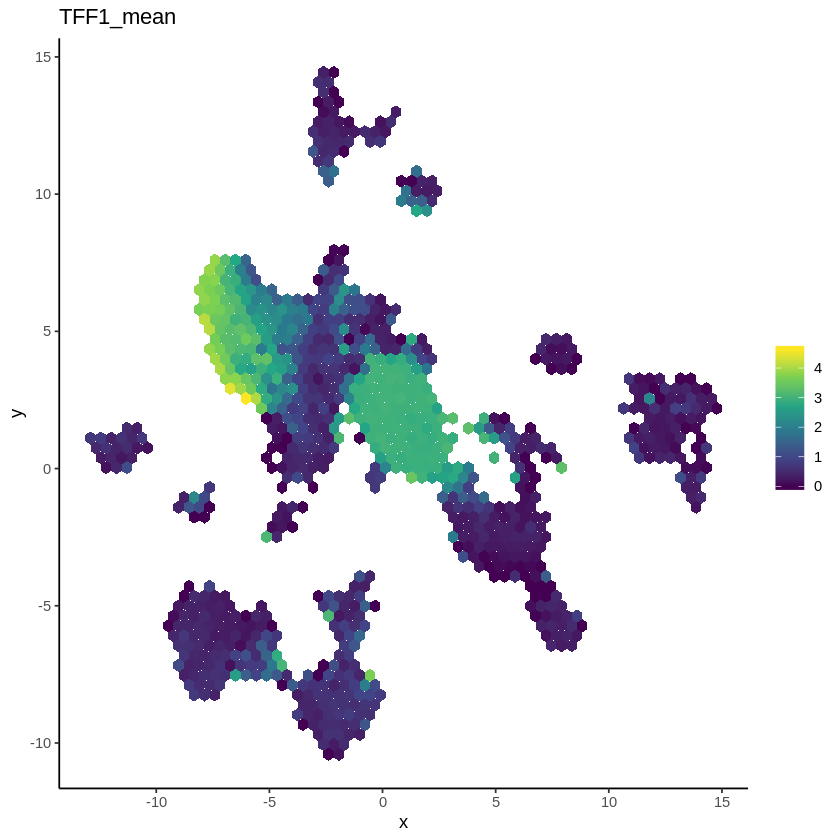

In [30]:
plot_hexbin_gene(data_MS4A1, type = 'logcounts', gene='TFF1',action='mean')

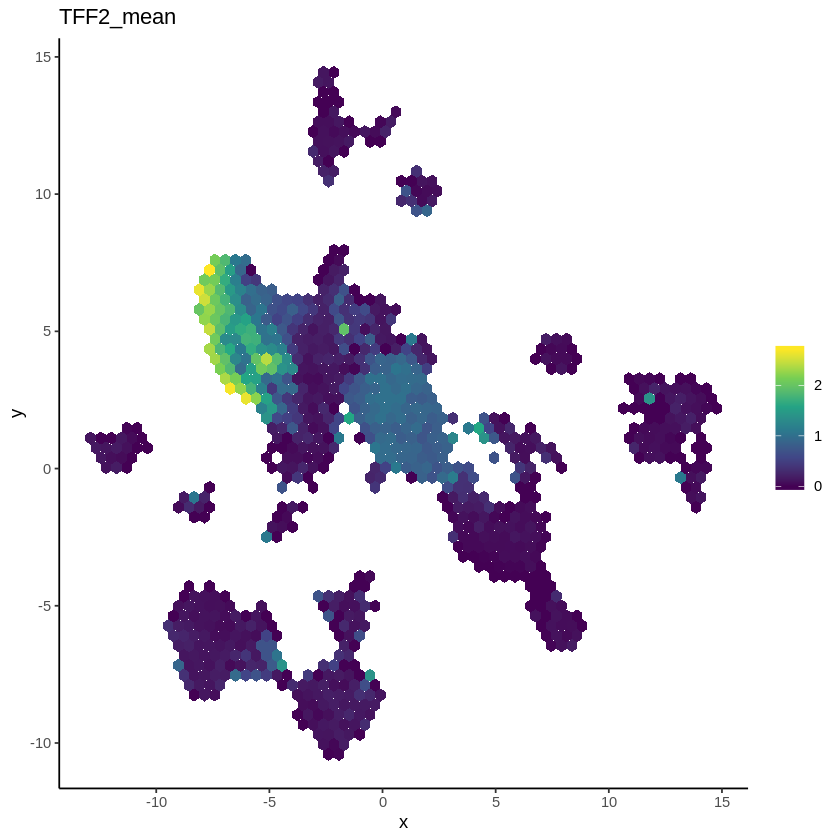

In [31]:
plot_hexbin_gene(data_MS4A1, type = 'logcounts', gene='TFF2',action='mean')

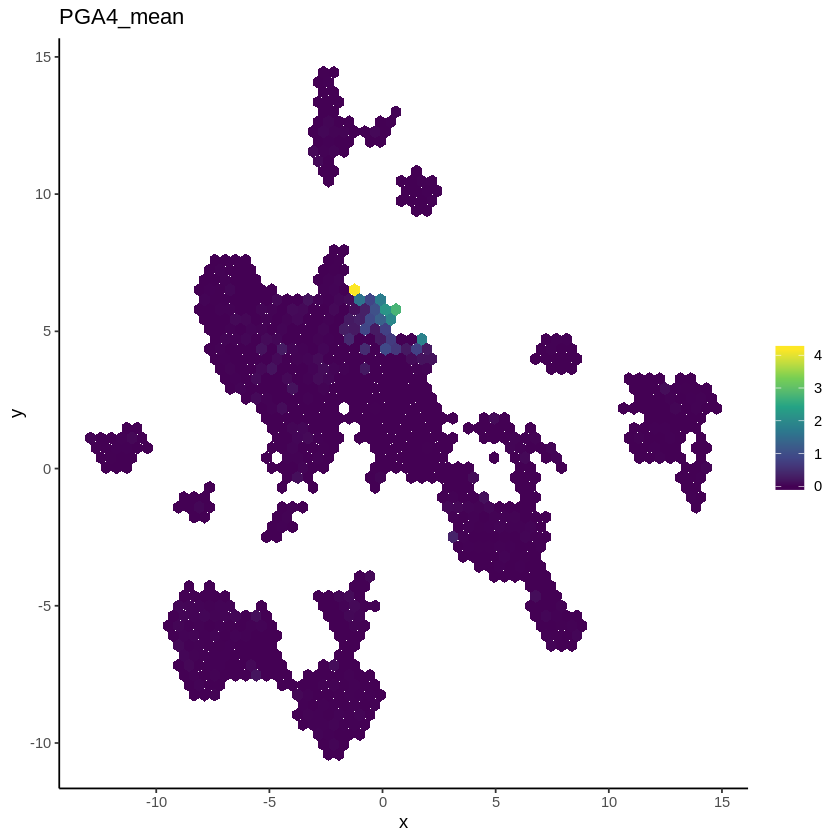

In [32]:
plot_hexbin_gene(data_MS4A1, type = 'logcounts', gene='PGA4',action='mean')

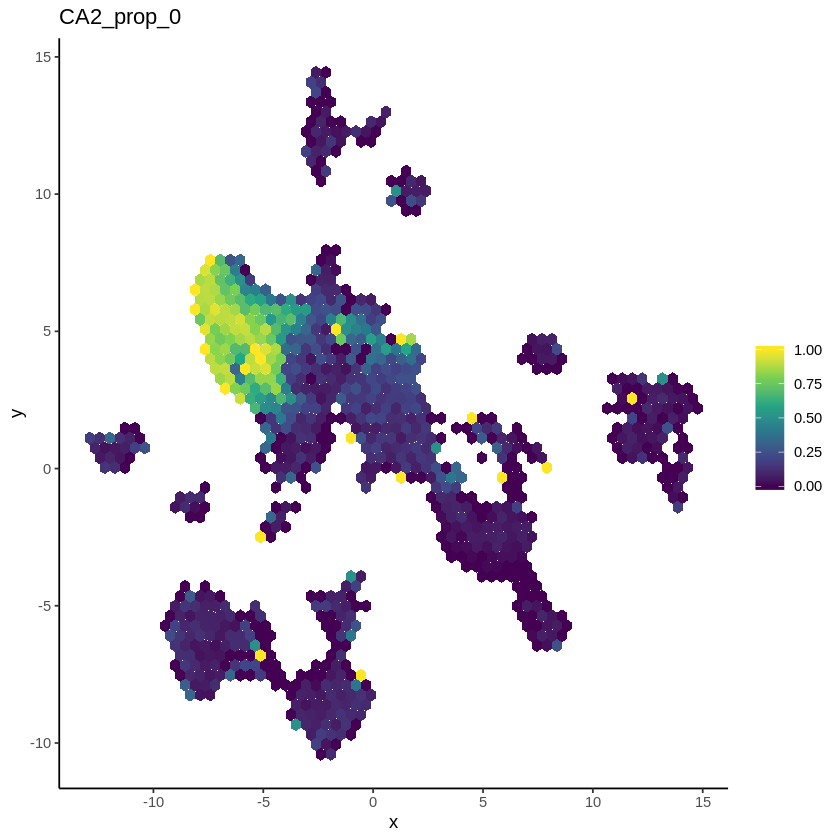

In [189]:
plot_hexbin_gene(data_MS4A1, type = 'logcounts', gene='CA2',action='mean')

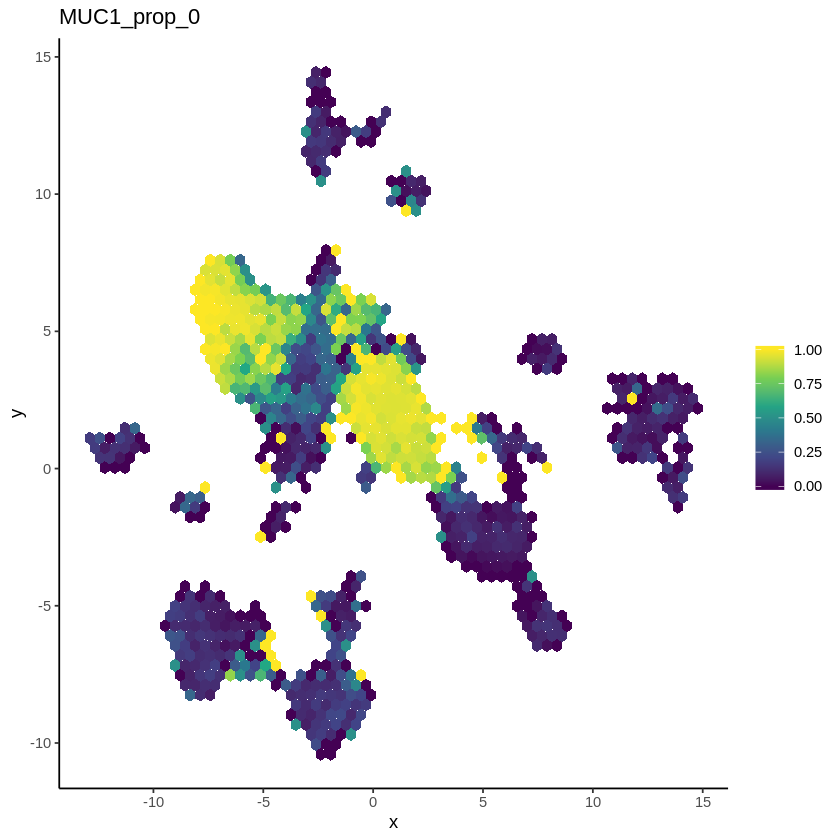

In [190]:
plot_hexbin_gene(data_MS4A1, type = 'logcounts', gene='MUC1',action='prop_0')

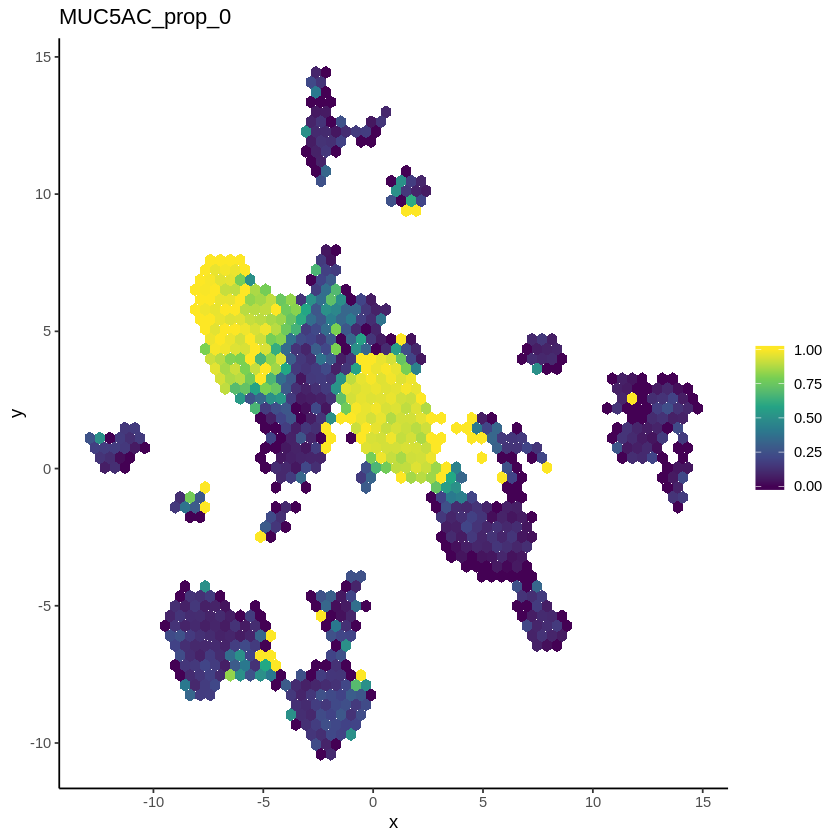

In [191]:
plot_hexbin_gene(data_MS4A1, type = 'logcounts', gene='MUC5AC',action='prop_0')

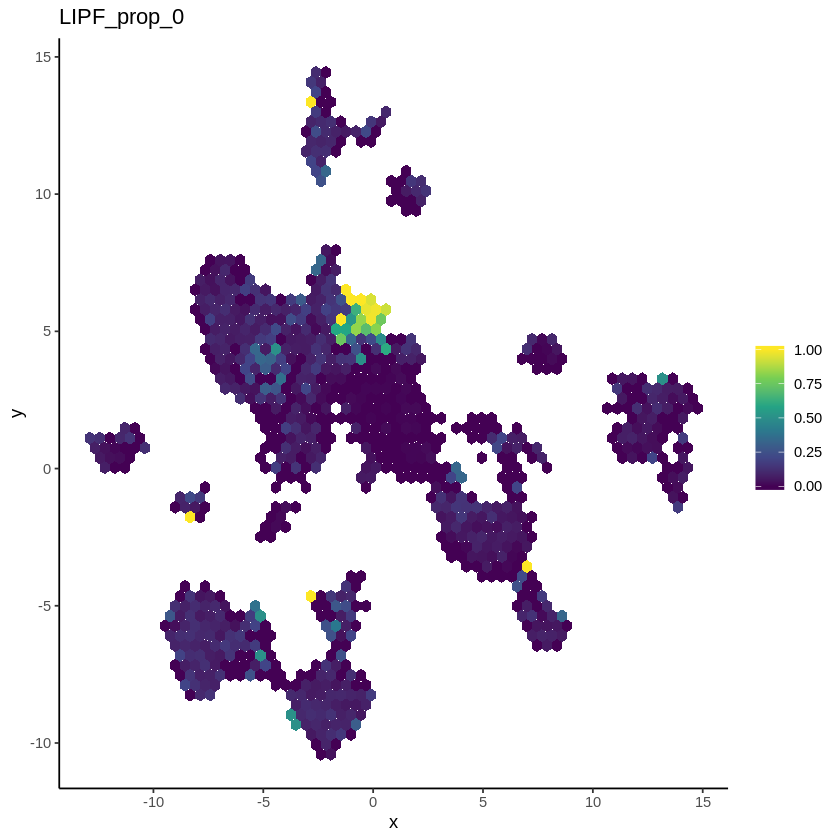

In [48]:
plot_hexbin_gene(data_MS4A1, type = 'logcounts', gene='LIPF',action='prop_0')

In [193]:
epi_markers <- c("TFF1","TFF2","PGA4","CA2","MUC1","MUC5AC","REG1A",
                 "GKN2","OLFM4","KRT19","SPINK1", "LCN2","ATP4B","SOX4",
                 "IFI6","MLN","KRT20","CEACAM5","CEACAM6","GIF", "ALDH1A1",
                 "CKB","BEST4","GUCA2A","CHGA","PCSK1N","GHRL","TACSTD2",
                 "CCDC80","IGFBP6","GAST","CEL")

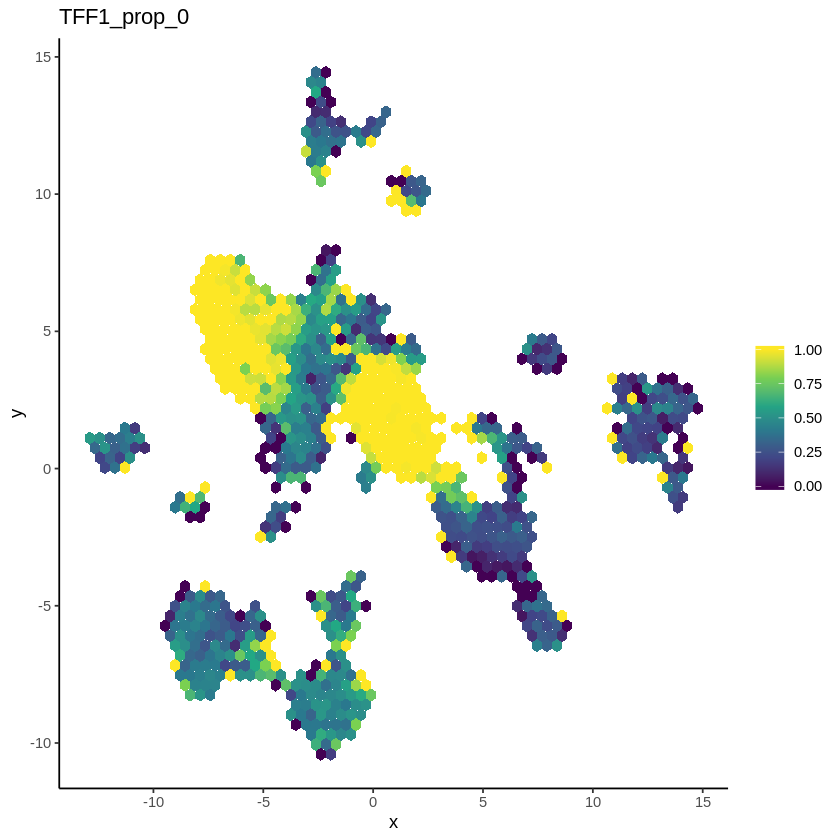

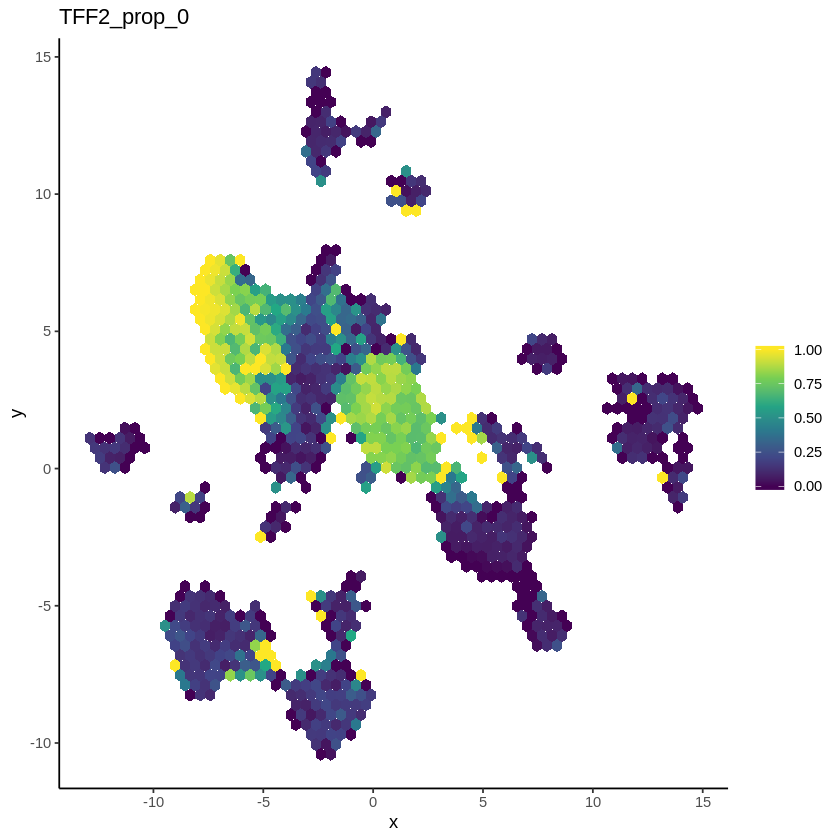

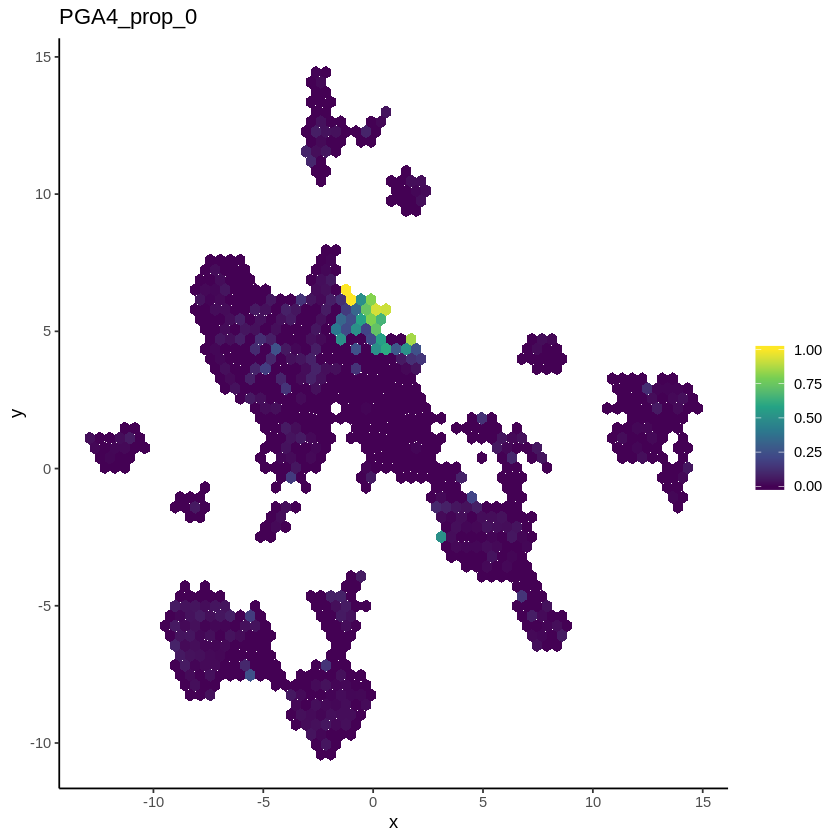

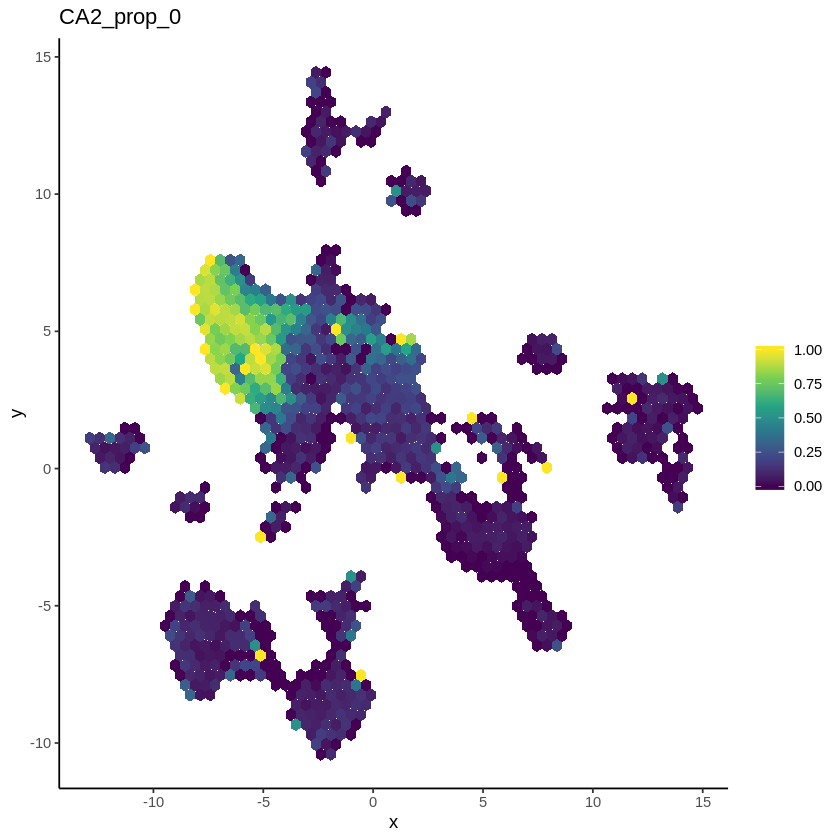

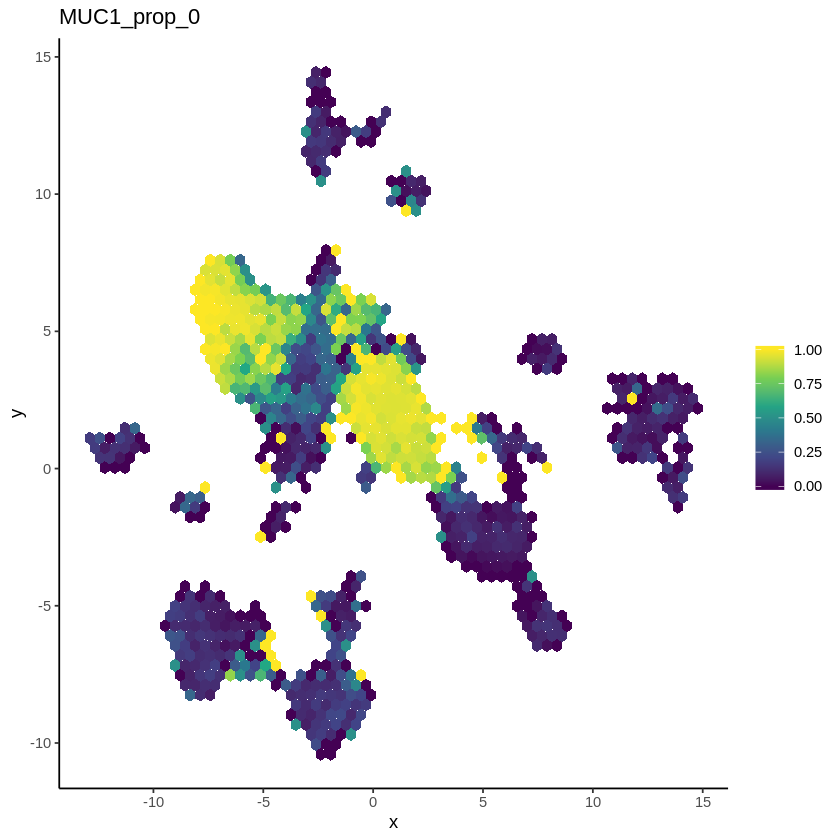

...

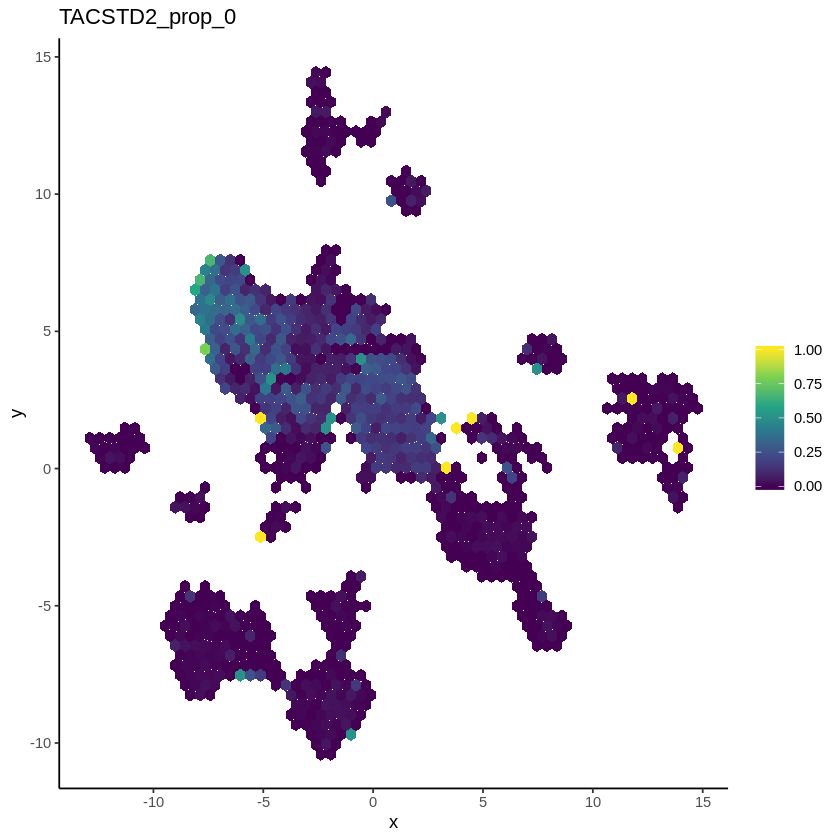

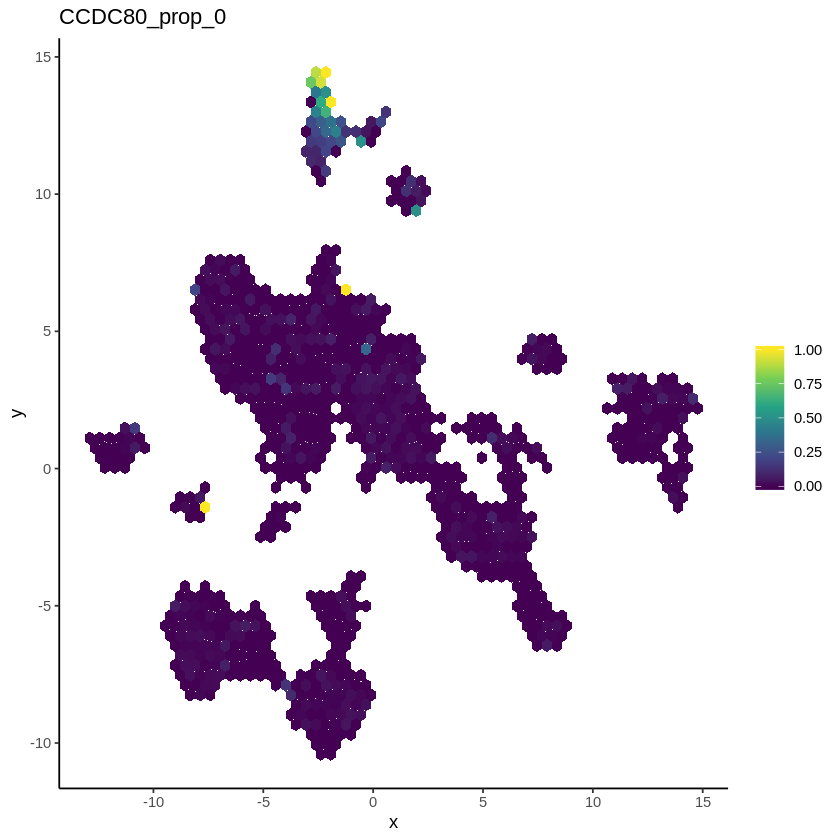

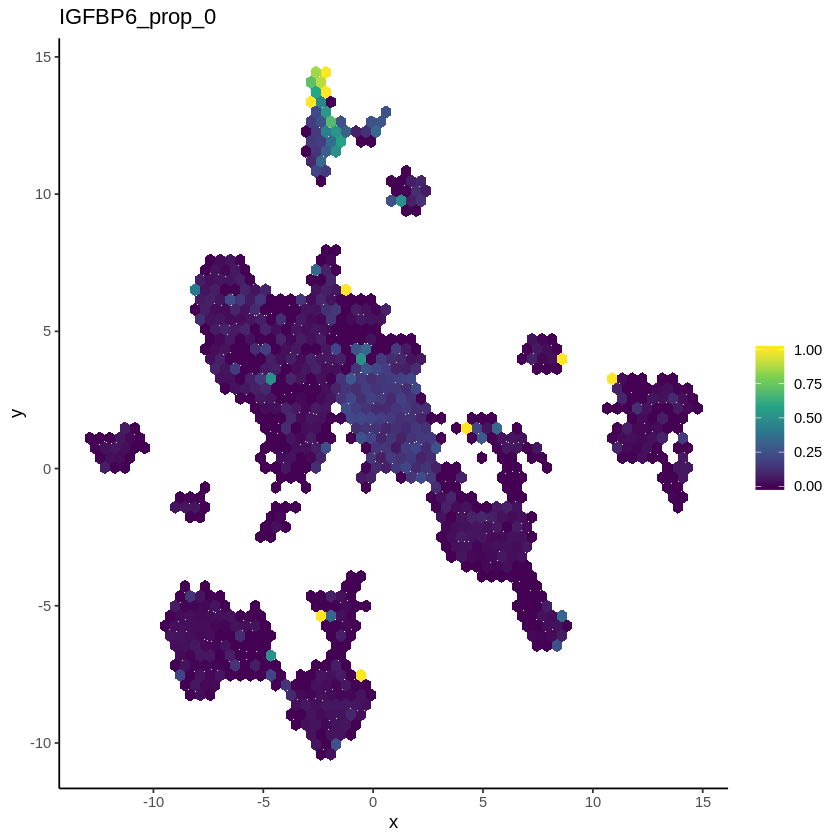

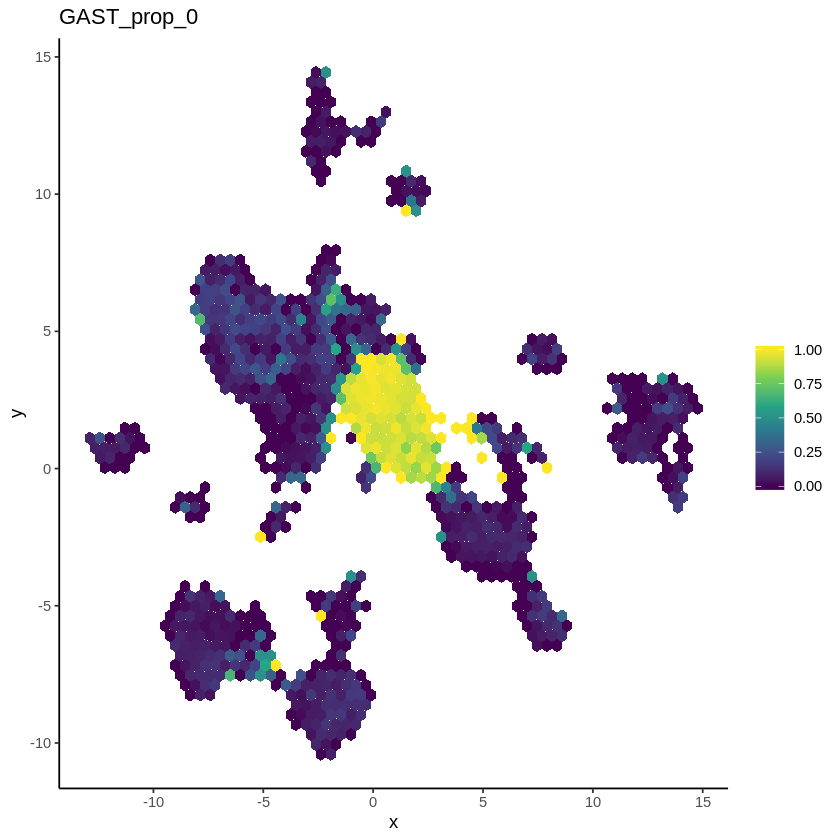

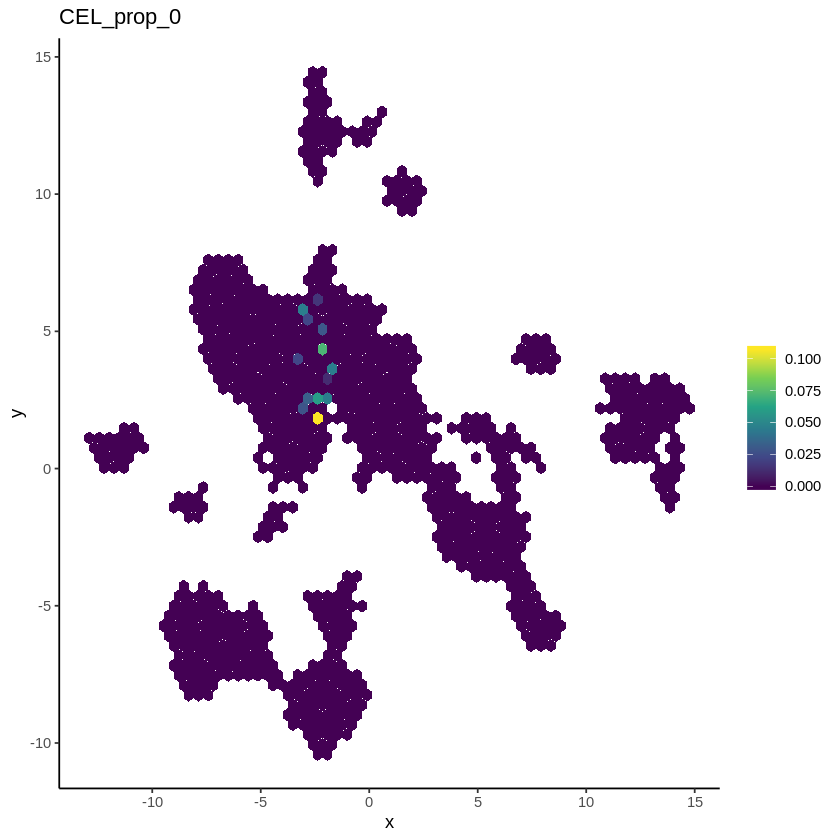

In [197]:
for (i in 1:length(epi_markers)){
    p1 <- plot_hexbin_gene(data_MS4A1, type = 'logcounts', gene=epi_markers[i],action='prop_0')
    plot(p1)
}

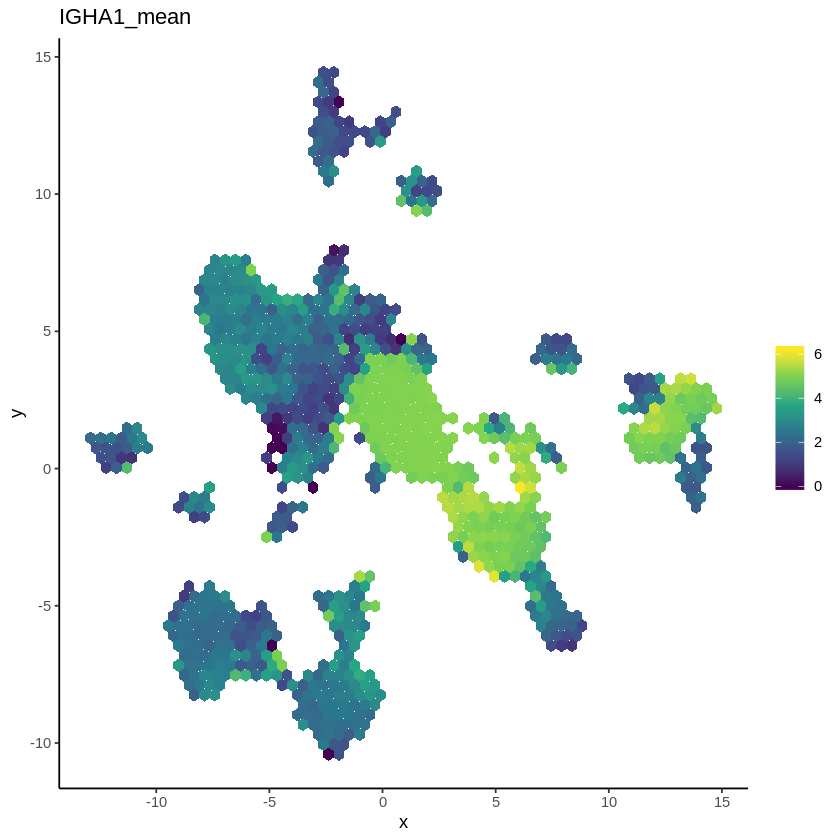

In [42]:
plot_hexbin_gene(data_MS4A1, type = 'logcounts', gene='IGHA1',action='mean')

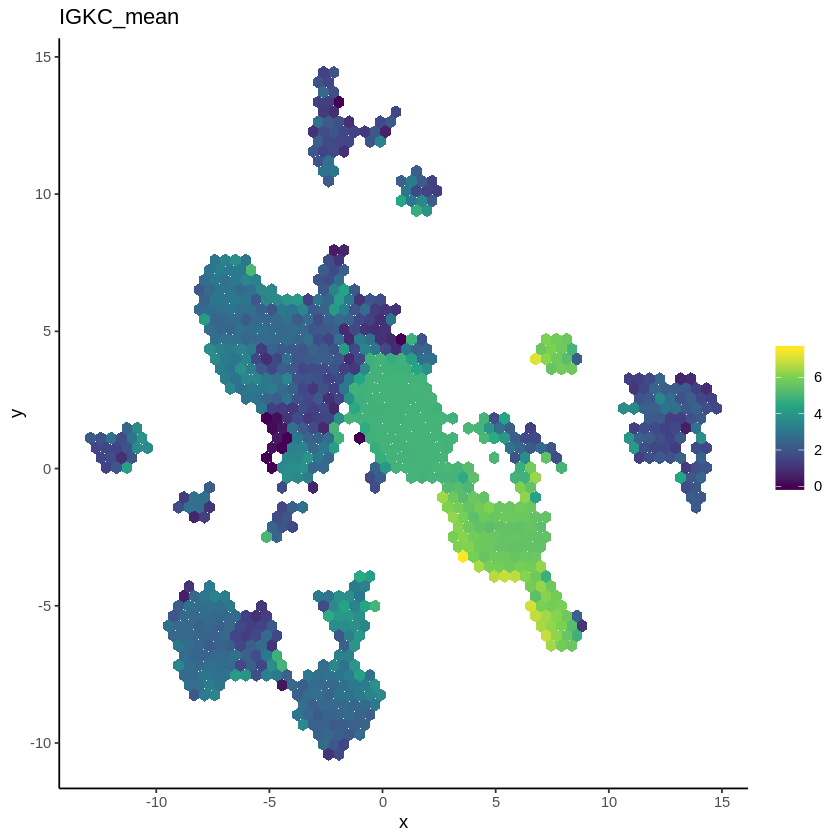

In [44]:
plot_hexbin_gene(data_MS4A1, type = 'logcounts', gene='IGKC',action='mean')

In [194]:
#---------#---------#---------#---------#---------#---------#---------#---------#---------

In [41]:
# FindAllMarkers
# The min.pct argument requires a feature to be detected at a minimum percentage in either of the two groups of cells, 
# and the thresh.test argument requires a feature to be differentially expressed (on average) 
# by some amount between the two groups. 
# You can set both of these to 0, but with a dramatic increase in time 
# - since this will test a large number of features that are unlikely to be highly discriminatory. 
# As another option to speed up these computations, max.cells.per.ident can be set. 
# This will downsample each identity class to have no more cells than whatever this is set to. 
# While there is generally going to be a loss in power, 
# the speed increases can be significiant and the most highly differentially expressed features will likely still rise to the top.

# 計算済み
all.markers <- FindAllMarkers(object = data.integrated, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 21

Calculating cluster 22

Calculating cluster 23

Calculating cluster 24

Calculating cluster 25

Calculating cluster 26

Calculating cluster 27



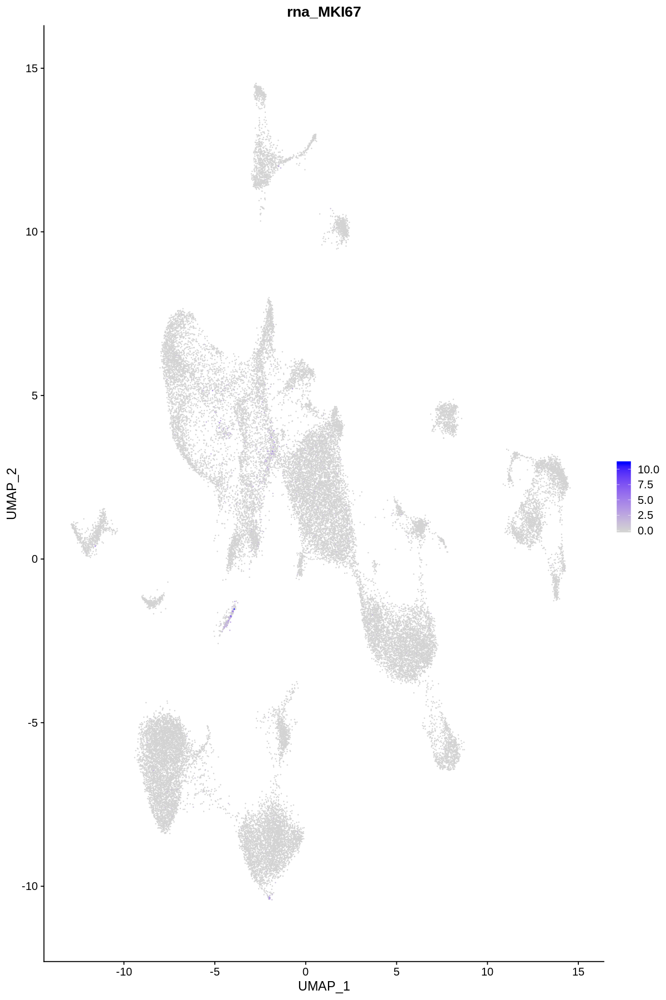

In [58]:
FeaturePlot(object = data.integrated, features = c("rna_MKI67"))

In [59]:
all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC) 

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
6.896267e-277,0.2605952,0.532,0.282,2.06888e-273,0,UQCR10
0.000000e+00,1.3773169,0.975,0.243,0.00000e+00,1,HLA-DRA
0.000000e+00,1.2098945,0.958,0.304,0.00000e+00,1,CD74
0.000000e+00,1.2061000,0.942,0.221,0.00000e+00,1,CXCR4
0.000000e+00,1.0848225,0.993,0.426,0.00000e+00,1,RPS27
0.000000e+00,0.9358401,0.921,0.347,0.00000e+00,1,BTG1
0.000000e+00,0.8739130,0.973,0.476,0.00000e+00,1,RPL39
0.000000e+00,0.8026125,0.973,0.452,0.00000e+00,1,RPS29
0.000000e+00,0.7279226,0.880,0.145,0.00000e+00,1,HLA-DPB1


In [60]:
save(all.markers, file='NewData-stomach-reference-markers20190907.RData')

In [91]:
all.markers %>% group_by(cluster)   %>% filter(cluster==0)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
6.896267e-277,0.2605952,0.532,0.282,2.06888e-273,0,UQCR10


In [89]:
all.markers %>% group_by(cluster) %>% filter(cluster==1)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,1.3773169,0.975,0.243,0.000000e+00,1,HLA-DRA
0.000000e+00,1.2098945,0.958,0.304,0.000000e+00,1,CD74
0.000000e+00,1.2061000,0.942,0.221,0.000000e+00,1,CXCR4
0.000000e+00,1.0848225,0.993,0.426,0.000000e+00,1,RPS27
0.000000e+00,0.9358401,0.921,0.347,0.000000e+00,1,BTG1
0.000000e+00,0.8739130,0.973,0.476,0.000000e+00,1,RPL39
0.000000e+00,0.8026125,0.973,0.452,0.000000e+00,1,RPS29
0.000000e+00,0.7279226,0.880,0.145,0.000000e+00,1,HLA-DPB1
0.000000e+00,0.7188647,0.924,0.143,0.000000e+00,1,HLA-DRB1


In [90]:
all.markers %>% group_by(cluster) %>%  filter(cluster==2)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,2.6606950,1.000,0.247,0,2,IGKC
0,2.1232511,0.999,0.255,0,2,IGHA1
0,1.7780161,1.000,0.261,0,2,JCHAIN
0,1.6709858,0.995,0.277,0,2,IGHA2
0,0.9694629,0.970,0.361,0,2,SSR4
0,0.9353996,0.941,0.304,0,2,MZB1
0,0.7118860,0.959,0.239,0,2,ANKRD28
0,0.6102864,0.806,0.312,0,2,HERPUD1
0,0.5611652,0.776,0.327,0,2,XBP1


In [92]:
all.markers %>% group_by(cluster)   %>% filter(cluster==3)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,1.2514577,0.756,0.120,0,3,KLRB1
0,1.0825262,0.744,0.074,0,3,CCL5
0,0.9656743,0.884,0.151,0,3,IL32
0,0.9613289,0.988,0.460,0,3,TMSB4X
0,0.8677149,0.928,0.072,0,3,CD3D
0,0.8336067,0.977,0.481,0,3,B2M
0,0.8153800,0.641,0.093,0,3,CCL4
0,0.8013004,0.921,0.178,0,3,PTPRC
0,0.7950679,0.883,0.216,0,3,S100A4


In [93]:
all.markers %>% group_by(cluster)  %>% filter(cluster==4)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,2.5083521,0.939,0.266,0,4,GKN1
0,2.3569882,0.974,0.183,0,4,MUC5AC
0,2.2282398,0.985,0.278,0,4,TFF1
0,2.0951522,0.921,0.198,0,4,GKN2
0,1.8350132,0.939,0.246,0,4,PSCA
0,1.7765309,0.954,0.203,0,4,MUC1
0,1.7479119,0.948,0.211,0,4,TFF2
0,1.4839921,0.925,0.233,0,4,S100P
0,1.4308151,0.910,0.129,0,4,MUCL3


In [94]:
all.markers %>% group_by(cluster) %>% filter(cluster==5)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,0.8815862,0.823,0.323,0.000000e+00,5,PHGR1
0.000000e+00,0.7996391,0.793,0.403,0.000000e+00,5,S100A6
0.000000e+00,0.6995018,0.819,0.284,0.000000e+00,5,TSPAN8
0.000000e+00,0.6766132,0.840,0.471,0.000000e+00,5,TMSB10
0.000000e+00,0.6707429,0.670,0.259,0.000000e+00,5,REG1A
0.000000e+00,0.6373446,0.767,0.437,0.000000e+00,5,GAPDH
0.000000e+00,0.5127155,0.734,0.288,0.000000e+00,5,KRT8
0.000000e+00,0.4361359,0.671,0.328,0.000000e+00,5,ATP5MD
0.000000e+00,0.3980837,0.865,0.243,0.000000e+00,5,ADIRF


In [95]:
all.markers %>% group_by(cluster)   %>% filter(cluster==6)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,2.3808768,0.995,0.301,0,6,TFF1
0,2.1806473,0.913,0.289,0,6,GKN1
0,1.8107663,0.955,0.235,0,6,TFF2
0,1.6737973,0.909,0.223,0,6,GKN2
0,1.4525219,0.928,0.266,0,6,AGR2
0,1.3663984,0.944,0.255,0,6,S100P
0,1.2309579,0.946,0.260,0,6,KRT19
0,1.2015756,0.883,0.271,0,6,PSCA
0,1.1655124,0.954,0.405,0,6,S100A6


In [97]:
all.markers %>% group_by(cluster) %>% filter(cluster==7)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,1.7731346,0.885,0.216,0.000000e+00,7,PIGR
0.000000e+00,1.6292021,0.852,0.334,0.000000e+00,7,PHGR1
0.000000e+00,1.6109884,0.996,0.444,0.000000e+00,7,MT-CO2
0.000000e+00,1.5986550,0.995,0.458,0.000000e+00,7,MT-ND1
0.000000e+00,1.5909271,0.997,0.488,0.000000e+00,7,MT-CO3
0.000000e+00,1.5406743,0.992,0.450,0.000000e+00,7,MT-CYB
0.000000e+00,1.5092272,0.995,0.480,0.000000e+00,7,MT-CO1
0.000000e+00,1.4662610,0.993,0.487,0.000000e+00,7,MT-ATP6
0.000000e+00,1.4152638,0.992,0.440,0.000000e+00,7,MT-ND4


In [98]:
all.markers %>% group_by(cluster)   %>% filter(cluster==8)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,3.5023605,1.000,0.304,0.000000e+00,8,IGLC3
0.000000e+00,2.5115789,0.988,0.274,0.000000e+00,8,IGLC2
0.000000e+00,1.4890727,0.997,0.316,0.000000e+00,8,IGHA1
0.000000e+00,1.4381731,0.996,0.336,0.000000e+00,8,IGHA2
0.000000e+00,1.4016065,0.995,0.322,0.000000e+00,8,JCHAIN
0.000000e+00,1.0941213,0.983,0.411,0.000000e+00,8,SSR4
0.000000e+00,0.9300673,0.945,0.356,0.000000e+00,8,MZB1
0.000000e+00,0.5941125,0.971,0.298,0.000000e+00,8,ANKRD28
4.688454e-247,0.5566741,0.863,0.351,1.406536e-243,8,HSP90B1


In [231]:
levels(data.integrated)
# 0,7,8: plasma cell (0:kappa, 7,8: lambda)
# 10: macrophage
# 1,17,11: B cells
# 4,5: T cells (4: CD8+ T, 5: CD4+ T?)
# 13: chief cell
# 2: folveolar cells
# 15: parietal cells
# 20: neuroendocrine??
# 9,14,16: fibroblasts
# 6: 
# 19: metaplasia??
1,2,3,4,5,

[1] "0"  "1"  "2"  "3"  "4"  "5"  "6"  "7"  "8"  "9"  "10" "11" "12" "13" "14"
[16] "15" "16" "17" "18" "19" "20"

In [99]:
all.markers %>% group_by(cluster)  %>% filter(cluster==9)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,2.3762680,0.945,0.119,0,9,POSTN
0,2.2326633,0.951,0.115,0,9,CXCL14
0,2.1162918,0.958,0.067,0,9,COL3A1
0,1.6180476,0.929,0.111,0,9,IGFBP5
0,1.6152763,0.920,0.078,0,9,LUM
0,1.4571878,0.928,0.096,0,9,PDGFRA
0,1.4492074,0.947,0.047,0,9,COL1A2
0,1.4074628,0.916,0.067,0,9,CTGF
0,1.3698821,0.951,0.084,0,9,DCN


In [100]:
all.markers %>% group_by(cluster)   %>% filter(cluster==10)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,3.4157656,1.000,0.276,0.000000e+00,10,IGLC2
0.000000e+00,1.5497059,1.000,0.318,0.000000e+00,10,IGHA1
0.000000e+00,1.5108350,0.999,0.323,0.000000e+00,10,JCHAIN
0.000000e+00,1.4322551,0.993,0.338,0.000000e+00,10,IGHA2
0.000000e+00,1.0881449,0.987,0.412,0.000000e+00,10,SSR4
5.931385e-300,0.7383234,0.934,0.358,1.779415e-296,10,MZB1
2.211927e-273,0.6198177,0.857,0.301,6.635781e-270,10,DERL3
6.384976e-227,0.5452065,0.924,0.415,1.915493e-223,10,TSC22D3
4.929256e-221,0.5429220,0.838,0.353,1.478777e-217,10,HSP90B1


In [101]:
all.markers %>% group_by(cluster) %>% filter(cluster==11)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,3.7572728,0.968,0.271,0.000000e+00,11,IGHG1
0.000000e+00,3.3113628,0.908,0.300,0.000000e+00,11,IGHG3
0.000000e+00,2.7425963,0.923,0.267,0.000000e+00,11,IGHG4
0.000000e+00,2.5959368,0.948,0.184,0.000000e+00,11,IGHG2
0.000000e+00,1.7395929,1.000,0.314,0.000000e+00,11,IGKC
1.723922e-274,0.8546693,0.924,0.361,5.171767e-271,11,MZB1
2.829490e-247,0.4635008,0.981,0.302,8.488471e-244,11,ANKRD28
1.047822e-229,0.7102204,0.935,0.416,3.143465e-226,11,SSR4
3.870817e-178,0.2560496,0.778,0.175,1.161245e-174,11,IGKV3-20


In [102]:
all.markers %>% group_by(cluster)   %>% filter(cluster==12)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
9.737050e-286,1.0641231,0.964,0.564,2.921115e-282,12,MALAT1
3.891961e-273,0.5819360,0.971,0.488,1.167588e-269,12,MT-CO1
3.340307e-252,0.5349721,0.964,0.496,1.002092e-248,12,MT-CO3
3.712857e-235,0.5404499,0.934,0.456,1.113857e-231,12,MT-ND3
4.072071e-230,0.4694836,0.756,0.171,1.221621e-226,12,CLEC2D
1.979975e-213,0.4558519,0.917,0.453,5.939924e-210,12,MT-CO2
1.109043e-205,0.3811233,0.822,0.187,3.327129e-202,12,ETS1
2.177277e-205,0.4880518,0.897,0.458,6.531832e-202,12,MT-ND2
6.152048e-171,0.3540766,0.881,0.450,1.845614e-167,12,MT-ND4


In [103]:
all.markers %>% group_by(cluster) %>% filter(cluster==13)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0,2.3865469,0.984,0.504,0,13,FTL
0,2.1301280,0.972,0.329,0,13,HLA-DRA
0,1.8870836,0.979,0.495,0,13,FTH1
0,1.8466347,0.901,0.310,0,13,LYZ
0,1.7919360,0.953,0.126,0,13,TYROBP
0,1.7528696,0.955,0.381,0,13,CD74
0,1.6360236,0.957,0.234,0,13,HLA-DRB1
0,1.5972646,0.930,0.096,0,13,C1QA
0,1.5782310,0.946,0.232,0,13,PSAP


In [104]:
all.markers %>% group_by(cluster)   %>% filter(cluster==14)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,3.9834381,1.000,0.304,0.000000e+00,14,IGHM
5.866785e-296,0.2795450,0.971,0.217,1.760036e-292,14,MIR155HG
3.764809e-281,1.7245999,0.989,0.318,1.129443e-277,14,IGKC
3.139044e-266,1.4712120,1.000,0.330,9.417132e-263,14,JCHAIN
7.042208e-254,0.3159898,0.971,0.283,2.112662e-250,14,BIRC3
3.739033e-229,0.4073424,0.927,0.238,1.121710e-225,14,IGKV4-1
1.065786e-205,0.8167607,0.933,0.364,3.197359e-202,14,MZB1
3.080604e-162,0.3649127,0.947,0.266,9.241811e-159,14,VIM
1.675662e-155,0.5834739,0.847,0.358,5.026985e-152,14,HSP90B1


In [105]:
all.markers %>% group_by(cluster) %>% filter(cluster==15)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,3.5494497,0.974,0.261,0.000000e+00,15,PGC
9.747320e-302,1.3111326,0.982,0.276,2.924196e-298,15,CD24
2.465706e-293,1.3134820,0.954,0.242,7.397117e-290,15,ATP1B1
2.019327e-292,0.9963951,0.941,0.230,6.057980e-289,15,SLC12A2
1.306871e-288,0.4481683,0.894,0.156,3.920612e-285,15,CXADR
5.700275e-273,0.2813819,0.850,0.207,1.710082e-269,15,EPHB3
6.221929e-267,3.6922956,0.899,0.182,1.866579e-263,15,LIPF
3.095235e-252,0.2703754,0.878,0.169,9.285706e-249,15,SH3BGRL2
9.086100e-252,0.3307901,0.871,0.215,2.725830e-248,15,PDIA2


In [77]:
all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)  %>% filter(cluster==16)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,4.7679284,1.000,0.224,0.000000e+00,16,IGLL5
9.736434e-285,1.6211970,1.000,0.331,2.920930e-281,16,JCHAIN
1.126381e-272,1.1690678,0.992,0.418,3.379142e-269,16,SSR4
4.036311e-241,1.5307786,0.975,0.326,1.210893e-237,16,IGHA1
1.652921e-234,1.4996310,0.961,0.345,4.958764e-231,16,IGHA2
2.099042e-225,1.0281329,0.934,0.364,6.297126e-222,16,MZB1
1.408224e-186,0.8915184,0.815,0.166,4.224673e-183,16,IGLV2-8
4.803011e-174,1.2150952,0.805,0.143,1.440903e-170,16,IGLV1-40
2.103983e-48,1.2489537,0.649,0.155,6.311949e-45,16,IGLV2-14


In [106]:
all.markers %>% group_by(cluster) %>%  filter(cluster==17)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,1.2049558,0.957,0.039,0.000000e+00,17,VWF
0.000000e+00,1.1802492,0.985,0.049,0.000000e+00,17,PCAT19
0.000000e+00,0.9190801,0.964,0.071,0.000000e+00,17,CD93
0.000000e+00,0.8880246,0.981,0.082,0.000000e+00,17,CALCRL
0.000000e+00,0.8437470,0.974,0.124,0.000000e+00,17,THBD
0.000000e+00,0.7606886,0.940,0.046,0.000000e+00,17,CCL14
0.000000e+00,0.6868330,0.889,0.054,0.000000e+00,17,SLCO2A1
0.000000e+00,0.6344934,0.908,0.026,0.000000e+00,17,RAMP3
0.000000e+00,0.6009692,0.870,0.021,0.000000e+00,17,CLDN5


In [79]:
all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)  %>% filter(cluster==18)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
1.935889e-256,2.7132418,0.970,0.278,5.807667e-253,18,IGHG1
4.626447e-226,2.7931466,0.927,0.274,1.387934e-222,18,IGHG4
5.019011e-225,3.6111363,0.927,0.306,1.505703e-221,18,IGHG3
5.777455e-215,3.4324392,0.927,0.192,1.733236e-211,18,IGHG2
3.442145e-197,2.2812710,0.912,0.287,1.032643e-193,18,IGLC2
2.419285e-192,1.1022985,0.979,0.420,7.257855e-189,18,SSR4
4.091662e-186,3.1196653,0.893,0.317,1.227499e-182,18,IGLC3
1.204686e-138,0.7843219,0.887,0.367,3.614059e-135,18,MZB1
6.320671e-120,0.8692510,0.778,0.118,1.896201e-116,18,IGLV6-57


In [107]:
all.markers %>% group_by(cluster) %>% filter(cluster==19)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
2.002501e-284,2.253461,1.000,0.452,6.007502e-281,19,MT-ND4
2.268480e-284,2.535849,1.000,0.500,6.805440e-281,19,MT-CO3
1.044824e-283,2.179512,1.000,0.460,3.134473e-280,19,MT-ND3
1.339830e-283,2.462900,1.000,0.492,4.019489e-280,19,MT-CO1
3.308958e-281,2.084723,1.000,0.499,9.926874e-278,19,MT-ATP6
5.566359e-281,1.948657,1.000,0.461,1.669908e-277,19,MT-ND2
6.975405e-280,2.140049,1.000,0.457,2.092622e-276,19,MT-CO2
9.745341e-275,1.943960,1.000,0.463,2.923602e-271,19,MT-CYB
2.233341e-272,1.892502,1.000,0.470,6.700023e-269,19,MT-ND1


In [108]:
all.markers %>% group_by(cluster) %>% filter(cluster==20)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
1.373802e-189,1.7216722,0.974,0.302,4.121406e-186,20,SLC25A5
3.810117e-189,1.7701192,0.986,0.380,1.143035e-185,20,UQCRQ
1.206664e-183,1.5305903,0.965,0.342,3.619991e-180,20,ATP5MD
2.826853e-183,1.5600580,0.963,0.464,8.480559e-180,20,ATP5ME
5.610003e-183,0.4117494,0.922,0.210,1.683001e-179,20,EIF5A2
1.899095e-180,1.3337868,0.980,0.500,5.697286e-177,20,FTH1
3.070751e-180,1.8049144,0.991,0.287,9.212254e-177,20,PSCA
3.007068e-175,0.6972370,0.957,0.259,9.021205e-172,20,SH3YL1
1.342088e-174,1.2057670,0.983,0.247,4.026265e-171,20,VDAC1


In [82]:
all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)  %>% filter(cluster==21)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
4.229432e-225,5.3759502,1.000,0.164,1.268830e-221,21,HBA1
1.911138e-224,5.9654390,1.000,0.193,5.733414e-221,21,HBA2
6.660400e-48,0.5806141,0.706,0.233,1.998120e-44,21,SLC25A37


In [109]:
all.markers %>% group_by(cluster) %>%  filter(cluster==22)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
4.224417e-156,1.1114707,1.000,0.526,1.267325e-152,22,PTMA
6.909970e-150,1.2662965,0.975,0.325,2.072991e-146,22,HMGN2
1.218644e-138,1.0397883,0.968,0.410,3.655932e-135,22,HMGB1
3.717154e-137,1.2100798,0.961,0.293,1.115146e-133,22,H2AFZ
1.059455e-132,1.2278929,0.926,0.151,3.178366e-129,22,STMN1
8.400789e-120,1.3245775,0.922,0.254,2.520237e-116,22,TUBA1B
3.544229e-116,1.0873479,0.915,0.222,1.063269e-112,22,HMGB2
9.230016e-114,1.0827980,0.911,0.205,2.769005e-110,22,TUBB
1.635354e-109,1.0730229,0.872,0.138,4.906063e-106,22,PCLAF


In [110]:
all.markers %>% group_by(cluster) %>%  filter(cluster==23)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,1.1207838,0.934,0.036,0.000000e+00,23,PI16
0.000000e+00,0.7054733,0.948,0.058,0.000000e+00,23,PRELP
0.000000e+00,0.6306957,0.878,0.059,0.000000e+00,23,FBLN2
0.000000e+00,0.3599431,0.889,0.032,0.000000e+00,23,ADAMTSL4
7.198453e-294,0.3942717,0.860,0.061,2.159536e-290,23,FIBIN
7.025804e-285,0.5461072,0.871,0.056,2.107741e-281,23,CD248
1.047131e-273,0.3373864,0.897,0.052,3.141394e-270,23,PID1
9.765119e-273,0.2807105,0.860,0.056,2.929536e-269,23,PCDH7
5.720351e-268,0.2816083,0.900,0.062,1.716105e-264,23,MAMDC2


In [111]:
all.markers %>% group_by(cluster) %>% filter(cluster==24)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,0.4003213,0.891,0.054,0.000000e+00,24,TBX2
0.000000e+00,0.3532543,0.799,0.024,0.000000e+00,24,ELN
5.470142e-283,0.7627994,0.948,0.062,1.641043e-279,24,MCAM
2.484121e-222,0.3655146,0.900,0.090,7.452362e-219,24,ADAMTS4
1.635206e-220,0.4043181,0.873,0.104,4.905618e-217,24,SLC7A2
4.223092e-217,0.3026192,0.856,0.102,1.266928e-213,24,C1QTNF1
5.365020e-202,0.9988487,0.878,0.049,1.609506e-198,24,SNCG
2.243964e-196,0.4102150,0.886,0.077,6.731893e-193,24,ACKR3
1.590958e-184,1.0512502,0.926,0.082,4.772874e-181,24,BGN


In [112]:
all.markers %>% group_by(cluster) %>%  filter(cluster==25)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
1.809527e-158,0.8422760,0.940,0.177,5.428582e-155,25,SLC18A2
2.147736e-141,2.2178415,0.980,0.158,6.443208e-138,25,TPSAB1
8.226019e-133,2.5344048,0.975,0.158,2.467806e-129,25,TPSB2
1.166382e-128,1.4986149,0.930,0.167,3.499145e-125,25,CPA3
8.243752e-127,0.9772054,0.915,0.161,2.473125e-123,25,MS4A2
1.802821e-111,0.5999549,0.955,0.225,5.408462e-108,25,IL1RL1
3.303767e-109,0.4739403,0.841,0.171,9.911301e-106,25,GATA2
2.383822e-87,0.7842296,0.836,0.163,7.151467e-84,25,KIT
8.563836e-84,0.9369382,0.980,0.502,2.569151e-80,25,FTH1


In [113]:
all.markers %>% group_by(cluster) %>%filter(cluster==26)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
5.091284e-109,3.0939277,1.000,0.312,1.527385e-105,26,IGHM
2.404019e-99,2.7017913,0.994,0.291,7.212056e-96,26,IGLC2
4.431130e-91,0.6412970,0.954,0.173,1.329339e-87,26,IGLV2-8
4.492886e-84,1.6550715,1.000,0.338,1.347866e-80,26,JCHAIN
2.298823e-80,2.4941426,0.919,0.321,6.896469e-77,26,IGLC3
1.973514e-78,1.1028706,0.988,0.425,5.920543e-75,26,SSR4
9.064317e-61,0.8726082,0.936,0.371,2.719295e-57,26,MZB1
2.658688e-60,0.3742569,0.855,0.196,7.976064e-57,26,LINC01480
1.710899e-58,0.5697591,0.803,0.123,5.132696e-55,26,IGLV6-57


In [114]:
all.markers %>% group_by(cluster) %>%  filter(cluster==27)

p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
5.284105e-21,0.4624271,0.855,0.281,1.585231e-17,27,IGHG4
4.378446e-18,0.4979659,0.984,0.334,1.313534e-14,27,IGHA1
7.324137e-18,0.2762682,0.871,0.325,2.197241e-14,27,TFF1
2.715866e-17,0.3913072,0.968,0.354,8.147597e-14,27,IGHA2
8.655599e-11,0.2994231,0.645,0.259,2.596680e-07,27,TFF2
1.264586e-10,0.4846404,0.694,0.279,3.793759e-07,27,S100P
1.366031e-10,0.3150629,0.548,0.345,4.098092e-07,27,CST3
8.358115e-10,0.3396897,0.871,0.426,2.507434e-06,27,SSR4
6.847274e-05,0.3103723,0.403,0.244,2.054182e-01,27,MT1G
